In [6]:
from __future__ import annotations

from copy import deepcopy
from pathlib import Path
import sys
import warnings

import cartopy.crs as ccrs
import geopandas as gpd
import joblib
import matplotlib as mpl
from matplotlib import colors
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from shapely.geometry import box

sys.path.append("../")


from matplotlib.dates import DateFormatter
from tqdm.notebook import tqdm

from archive.visualizations.scripts.drawer import (
    hexes_plots_n,
    russia_plots,
    russia_plots_n,
)
from archive.visualizations.scripts.hex_utils import (
    build_hex_grid,
    suggest_hex_radius,
    to_equal_area,
)

gpd.options.io_engine = "pyogrio"

warnings.simplefilter(action="ignore", category=FutureWarning)

plt.rcParams["font.family"] = "DeJavu Serif"
plt.rcParams["font.serif"] = ["Times New Roman"]


### Read necessary geometry

In [7]:
gauges_file = gpd.read_file("../data/geometry/russia_gauges.gpkg")
gauges_file["gauge_id"] = gauges_file["gauge_id"].astype(str)
gauges_file = gauges_file.set_index("gauge_id")
ws_file = gpd.read_file("../data/geometry/russia_ws.gpkg")
ws_file = ws_file.set_index("gauge_id")
ws_file = ws_file[ws_file["new_area"] <= 50000]


def lim_definer(area: float) -> str:
    """Categorize watershed areas into different size classes.

    Args:
        area: Watershed area in square kilometers

    Returns:
        String label representing the size category with Cyrillic identifiers

    """
    lim_1, lim_2, lim_3, lim_4 = 100, 2000, 10000, 50000

    if area < lim_1:
        return "а) < 100 $км^2$"
    elif (area >= lim_1) & (area <= lim_2):
        return "б) 100 $км^2$ - 2 000 $км^2$"
    elif (area > lim_2) & (area <= lim_3):
        return "в) 2 000 $км^2$ - 10 000 $км^2$"
    elif (area > lim_3) & (area <= lim_4):
        return "г) 10 000 $км^2$ - 50 000 $км^2$"
    else:
        return "> 50 000 $км^2$"


ws_file["size"] = ws_file.loc[:, "new_area"].apply(lambda x: lim_definer(x))
ws_file["size"] = pd.Categorical(
    ws_file["size"],
    [
        "а) < 100 $км^2$",
        "б) 100 $км^2$ - 2 000 $км^2$",
        "в) 2 000 $км^2$ - 10 000 $км^2$",
        "г) 10 000 $км^2$ - 50 000 $км^2$",
    ],
)

basemap_data = gpd.read_file("../data/geometry/basemap_2023.gpkg")

basin_districts = gpd.read_file("../data/geometry/basin_districts_2024.gpkg")
basin_districts = basin_districts.reset_index(drop=True)
# basin_districts = basin_districts.drop([26, 27])
# fixed umgs shapes
basin_districts = basin_districts.reindex(
    [
        0,
        1,
        2,
        3,
        4,
        5,
        6,
        7,
        8,
        26,
        10,
        11,
        12,
        27,
        14,
        15,
        16,
        17,
        18,
        19,
        20,
        21,
        22,
        23,
        24,
        25,
        9,
        13,
    ]
)
basin_districts = basin_districts.reset_index(drop=True)
basin_districts = basin_districts.rename(columns={"BAS_OKRUG": "name1"})


In [8]:
def read_table_gauge_str(
    table_path: str, index_filter: pd.Index = pd.Index([])
) -> tuple[pd.DataFrame, float]:
    table = pd.read_csv(table_path)
    if "Unnamed: 0" in table.columns:
        table = table.rename(columns={"Unnamed: 0": "gauge_id"})
    table["gauge_id"] = table["gauge_id"].astype(str)
    table = table.set_index("gauge_id")

    if index_filter.empty:
        pass
    else:
        table = table.loc[table.index.isin(index_filter)]
    median_nse = table["NSE"].median()
    return table, median_nse

### Use only gauges from LSTM model

In [10]:
hbv_table = pd.read_csv(
    "../archive/conclusions/tables/HBV_res_mle_NSE.csv",
    index_col="gauge_id",
    dtype={"gauge_id": str},
)

gr4j_table = pd.read_csv(
    "../archive/conclusions/tables/GR4J_res_mle_NSE.csv",
    index_col="gauge_id",
    dtype={"gauge_id": str},
)
rfr_table = pd.read_csv(
    "../archive/conclusions/tables/res_rfr_cv.csv",
    index_col="gauge_id",
    dtype={"gauge_id": str},
)
lstm_regional = pd.read_csv(
    "../archive/conclusions/tables/cudalstm_q_mm_day_mswep_res.csv",
    index_col="gauge_id",
    dtype={"gauge_id": str},
)
lstm_single = pd.read_csv(
    "../archive/conclusions/tables/Single_LSTM_table.csv",
    index_col="gauge_id",
    dtype={"gauge_id": str},
)
lstm_no_static = pd.read_csv(
    "../archive/conclusions/tables/LSTM_no_static_res.csv",
    index_col="gauge_id",
    dtype={"gauge_id": str},
)

common_index = (
    hbv_table.index.intersection(gr4j_table.index)
    .intersection(rfr_table.index)
    .intersection(lstm_regional.index)
    .intersection(ws_file.index)
    .intersection(gauges_file.index)
    .intersection(lstm_single.index)
    .intersection(lstm_no_static.index)
)


ws_file = ws_file.loc[common_index, :]
gauges_file = gauges_file.loc[common_index, :]
gauges_file["size"] = np.nan
gauges_file = gauges_file.combine_first(ws_file)
gauges_file = gauges_file.set_crs(epsg=4326)

gauges_file.to_file("../data/geometry/full_gauges.gpkg", driver="GPKG")

In [11]:
EQ_AREA_CRS = "EPSG:6933"  # global equal-area; good default for Russia-scale maps


def to_equal_area(gdf: gpd.GeoDataFrame, crs: str = EQ_AREA_CRS) -> gpd.GeoDataFrame:
    """Project to an equal-area CRS for consistent hex areas."""
    if gdf.crs is None:
        raise ValueError("Input GeoDataFrame must have a CRS.")
    return gdf.to_crs(crs)


### Function usage here of hexes_plot

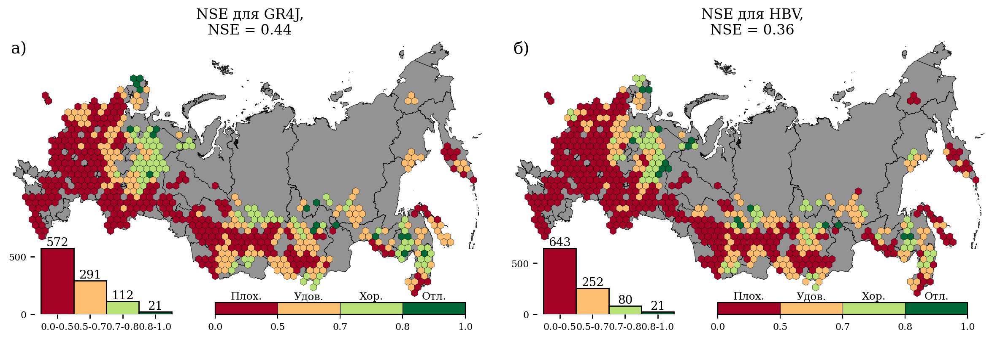

In [ ]:
ws_file["NSE HBV"] = hbv_table.loc[ws_file.index, "NSE"].clip(lower=0)
ws_file["NSE GR4J"] = gr4j_table.loc[ws_file.index, "NSE"].clip(lower=0)
nse_gr4j = ws_file["NSE GR4J"].median()
nse_hbv = ws_file["NSE HBV"].median()
fig, hex_maps, radius_km, coverage_stats = hexes_plots_n(
    watersheds=ws_file[["geometry", "NSE GR4J", "NSE HBV"]],
    basemap_data=basemap_data,
    metric_cols=["NSE GR4J", "NSE HBV"],
    label_list=["а)", "б)"],
    nrows=1,
    ncols=2,
    target_ws_per_hex=6.0,
    area_weighted=True,
    min_overlap_share=0.15,
    quantile=0.5,
    list_of_limits=[0.0, 0.5, 0.7, 0.8, 1.0],
    figsize=(15, 10),
    basemap_alpha=0.85,
    with_histogram=True,
    cb_label=["Плох.", "Удов.", "Хор.", "Отл."],
    title_text=[
        f"NSE для GR4J,\nNSE = {nse_gr4j:.2f}",
        f"NSE для HBV,\nNSE = {nse_hbv:.2f}",
    ],
)

### HBV and GR4J

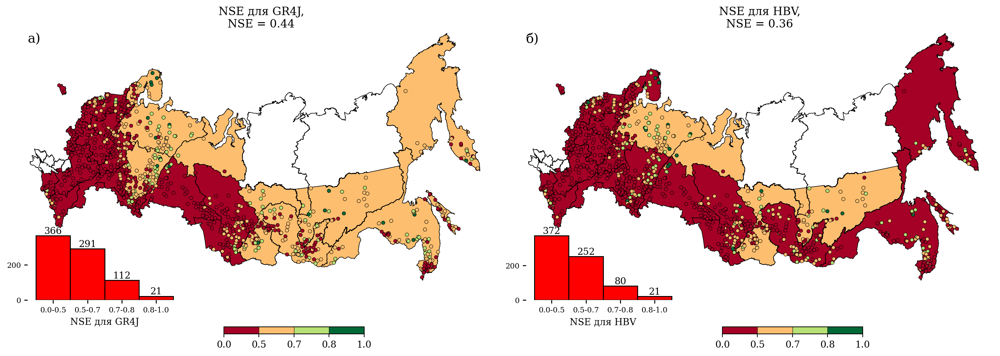

In [12]:
hbv_table, nse_hbv = read_table_gauge_str(
    table_path="../archive/conclusions/tables/HBV_res_mle_NSE.csv",
    index_filter=common_index,
)
gr4j_table, nse_gr4j = read_table_gauge_str(
    table_path="../archive/conclusions/tables/GR4J_res_mle_NSE.csv",
    index_filter=common_index,
)

hbv_gr4j_nse = gauges_file.loc[:, ["geometry"]]

hbv_gr4j_nse.loc[:, ["NSE GR4J", "NSE HBV"]] = pd.concat(
    [gr4j_table.loc[common_index, "NSE"], hbv_table.loc[common_index, "NSE"]],
    axis=1,
).values


for i, geom in enumerate(basin_districts["geometry"]):
    ugms_part = hbv_gr4j_nse.loc[
        [geom.intersects(gage_point) for gage_point in hbv_gr4j_nse["geometry"]],
        :,
    ]
    ugms_name = basin_districts.loc[i, "name1"]

    basin_districts.loc[i, ["NSE GR4J", "NSE HBV"]] = ugms_part[
        ["NSE GR4J", "NSE HBV"]
    ].median()

basin_districts.loc[[26, 27], ["NSE GR4J", "NSE HBV"]] = np.nan

meteo_nse = russia_plots_n(
    gdf_to_plot=hbv_gr4j_nse,
    basemap_data=basemap_data,
    figsize=(15, 10),
    nrows=1,
    ncols=2,
    label_list=["а)", "б)"],
    columns_from_gdf=["NSE GR4J", "NSE HBV"],
    hist_name=["NSE для GR4J", "NSE для HBV"],
    with_histogram=True,
    title_text=[
        f"NSE для GR4J,\nNSE = {nse_gr4j:.2f}",
        f"NSE для HBV,\nNSE = {nse_hbv:.2f}",
    ],
    ugms=True,
    ugms_gdf=basin_districts,
)


In [ ]:
# Replace NSE values less than 0 with 0 for both NSE columns
hbv_gr4j_nse["NSE GR4J"] = hbv_gr4j_nse["NSE GR4J"].clip(lower=0)
hbv_gr4j_nse["NSE HBV"] = hbv_gr4j_nse["NSE HBV"].clip(lower=0)

In [ ]:
import matplotlib.pyplot as plt
import numpy as np


def create_nse_boxplots(
    df,
    nse_columns,
    figsize=(14, 8),
    color="lightblue",
    save_path=None,
    max_cols=3,
):
    """Create boxplots for NSE columns in a dataframe.

    Args:
        df: DataFrame containing NSE columns
        nse_columns: List of column names containing NSE values
        figsize: Tuple of figure size (width, height)
        color: Color for the boxplots
        save_path: Optional path to save the figure as PNG (e.g., 'output/nse_boxplots.png')
        max_cols: Maximum number of columns in the subplot grid (default: 3)

    Returns:
        matplotlib.figure.Figure: The created figure

    """
    n_cols = len(nse_columns)
    ncols = min(n_cols, max_cols)  # Maximum 3 columns
    nrows = (n_cols + ncols - 1) // ncols  # Calculate required rows

    fig, axes = plt.subplots(nrows, ncols, figsize=figsize)

    # Ensure axes is always a list for consistent indexing
    if n_cols == 1:
        axes = [axes]
    elif nrows == 1:
        axes = axes.flatten()
    else:
        axes = axes.flatten()

    # Russian alphabet letters for labeling
    russian_labels = [
        "а)",
        "б)",
        "в)",
        "г)",
        "д)",
        "е)",
        "ж)",
        "з)",
        "и)",
        "к)",
    ]

    for i, col in enumerate(nse_columns):
        ax = axes[i]

        # Calculate statistics
        median_val = df[col].median()
        total_gauges = len(df[col].dropna())
        satisfactory = (df[col] >= 0.5).sum()
        satisfactory_pct = satisfactory / total_gauges * 100 if total_gauges > 0 else 0

        # Create boxplot
        df[col].plot.box(
            ax=ax,
            patch_artist=True,
            boxprops=dict(facecolor=color, alpha=0.7),
            medianprops=dict(color="red", linewidth=2),
            whiskerprops=dict(linewidth=1.5),
            capprops=dict(linewidth=1.5),
            flierprops=dict(marker="o", markerfacecolor="red", markersize=4, alpha=0.5),
        )

        # Customize the plot
        title = f"Медиана: {median_val:.2f}, NSE≥0.5: {satisfactory} ({satisfactory_pct:.1f}%)"
        ax.set_title(title, fontsize=14, pad=20)
        ax.set_ylabel("NSE", fontsize=14)
        ax.tick_params(axis="both", which="major", labelsize=12)
        ax.grid(True, alpha=0.3, linestyle="--")

        # Add Russian alphabet label in top right corner
        if i < len(russian_labels):
            ax.text(
                0.95,
                0.95,
                russian_labels[i],
                transform=ax.transAxes,
                fontsize=16,
                ha="right",
                va="top",
                bbox=dict(boxstyle="round,pad=0.3", facecolor="white", alpha=0.8),
            )

        # Limit NSE axis to 0-1.0 for better visibility
        ax.set_ylim(0, 1.0)

        # Add horizontal line at NSE = 0.5
        ax.axhline(
            y=0.5,
            color="orange",
            linestyle="--",
            alpha=0.8,
            linewidth=2,
        )

    # Hide unused subplots
    for i in range(n_cols, len(axes)):
        axes[i].set_visible(False)

    plt.tight_layout()

    # Save figure if path is provided
    if save_path:
        fig.savefig(save_path, format="png", dpi=300, bbox_inches="tight")
    return fig


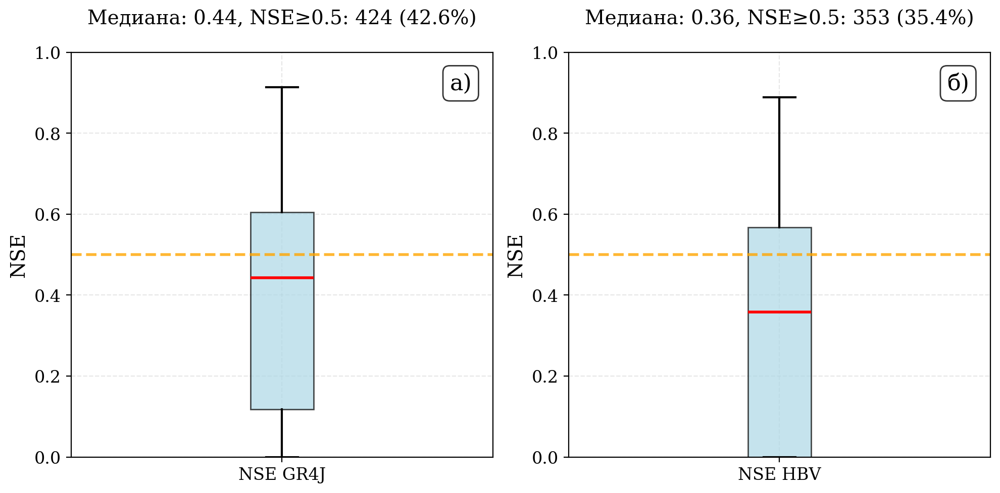

In [ ]:
# Usage example:
fig = create_nse_boxplots(
    df=hbv_gr4j_nse,
    nse_columns=["NSE GR4J", "NSE HBV"],
    figsize=(10, 5),
    max_cols=2,
    color="lightblue",
    save_path="../conclusions/images/Gr4jHBV_boxplots.png",  # Specify the path to save the figure,
)
plt.show()


In [ ]:
basin_districts.loc[:, ["name1", "NSE GR4J", "NSE HBV"]].dropna().to_csv(
    "../data/dw_tables/bo_hbv_gr4j.csv", index=False
)
gr4j_hbv = pd.concat([hbv_table.median().to_frame().T, gr4j_table.median().to_frame().T])

gr4j_hbv.index = pd.Index(["HBV", "GR4J"])
gr4j_hbv.index.name = "Модель"
gr4j_hbv.to_excel("../data/dw_tables/gr4j_hbv_statistics.xlsx", float_format="%.2f")


### Random forest

#### Calculate files from Random Forest results

In [ ]:
rfr_metric = []
for gauge_id in tqdm(
    [i.stem for i in Path("../data/conceptual_models/rfr_cv/").glob("*.joblib")]
):
    _, test = read_gauge(gauge_id=gauge_id, simple=True)

    X_test = deepcopy(test)
    for days in (2**n for n in range(6)):
        X_test[[f"prcp_{days}"]] = test[["prcp_e5l"]].rolling(window=days).sum()
        X_test[[f"t_min_mean_{days}"]] = test[["t_min_e5l"]].rolling(window=days).mean()
        X_test[[f"t_max_mean_{days}"]] = test[["t_min_e5l"]].rolling(window=days).mean()
    X_test = X_test.dropna()

    feature_cols = [
        item
        for sublist in [
            [f"{var}_{day}" for day in (2**n for n in range(6))]
            for var in [
                "prcp",
                "t_min_mean",
                "t_max_mean",
            ]  # "t_min_sum", "t_max_sum"]
        ]
        for item in sublist
    ]
    X_test = X_test[feature_cols]
    X_test = X_test.to_numpy()
    # create target
    Y_test = test[["q_mm_day"]]
    Y_test = Y_test.to_numpy().ravel()

    rfr_model = joblib.load(f"../data/conceptual_models/rfr_cv/{gauge_id}.joblib")
    # get prediction
    fin_df = test.iloc[31:, [0]]
    fin_df["q_mm_rfr"] = rfr_model.predict(X_test)

    rfr_metric.append(
        metric_df(
            gauge_id,
            predictions=fin_df["q_mm_rfr"],
            targets=fin_df["q_mm_day"],
        )
    )
pd.concat(rfr_metric).to_csv("../conclusions/tables/res_rfr_cv.csv")


  0%|          | 0/1048 [00:00<?, ?it/s]

FileNotFoundError: [Errno 2] No such file or directory: '/app/data/nc_all_q/75289.nc'

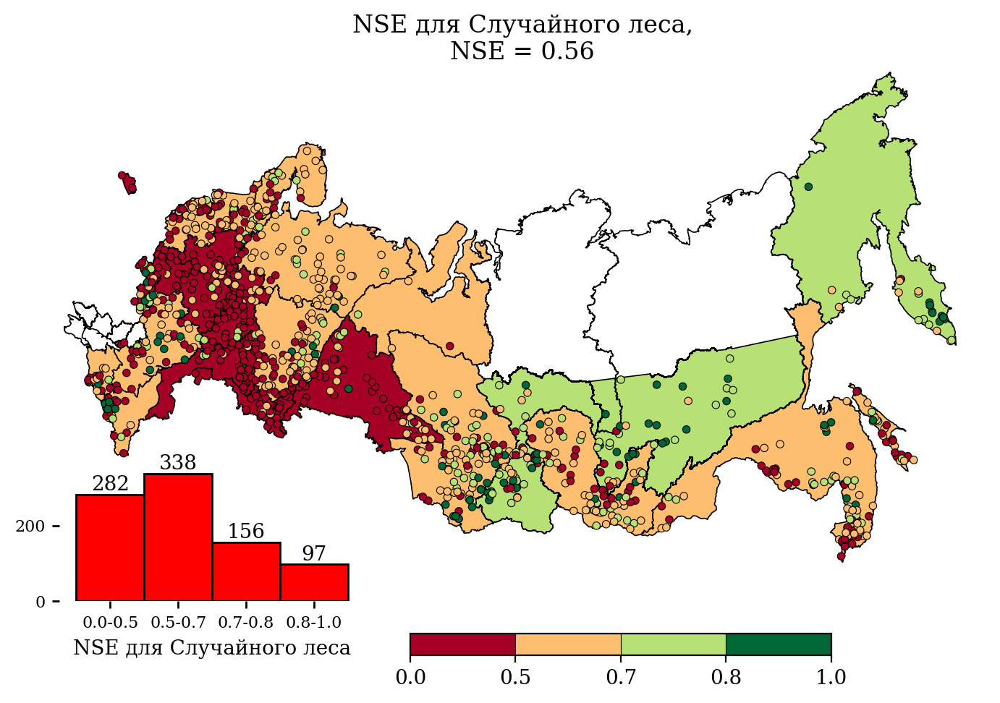

In [ ]:
rfr_table, rfr_nse = read_table_gauge_str(
    table_path="../conclusions/tables/res_rfr_cv.csv",
    index_filter=common_index,
)

rfr_geom_nse = gauges_file.loc[:, ["geometry"]]

rfr_geom_nse.loc[:, ["NSE Случайный лес"]] = pd.concat(
    [rfr_table.loc[common_index, "NSE"]],
    axis=1,
).values


for i, geom in enumerate(basin_districts["geometry"]):
    ugms_part = rfr_geom_nse.loc[
        [geom.intersects(gage_point) for gage_point in rfr_geom_nse["geometry"]],
        :,
    ]
    ugms_name = basin_districts.loc[i, "name1"]

    basin_districts.loc[i, ["NSE Случайный лес"]] = ugms_part[
        ["NSE Случайный лес"]
    ].median()

basin_districts.loc[[26, 27], ["NSE Случайный лес"]] = np.nan

meteo_nse = russia_plots_n(
    gdf_to_plot=rfr_geom_nse,
    basemap_data=basemap_data,
    figsize=(10, 5),
    nrows=1,
    ncols=1,
    label_list=[""],
    columns_from_gdf=["NSE Случайный лес"],
    hist_name=["NSE для Случайного леса"],
    with_histogram=True,
    title_text=[f"NSE для Случайного леса,\nNSE = {rfr_nse:.2f}"],
    ugms=True,
    ugms_gdf=basin_districts.sort_index(),
)


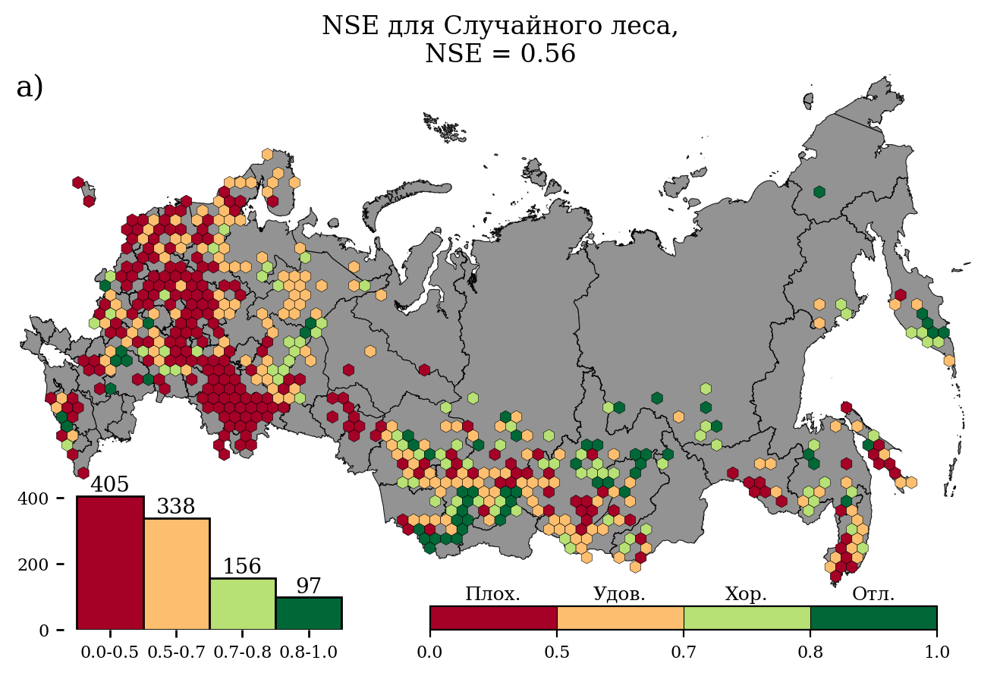

In [ ]:
ws_file["NSE Случайный лес"] = rfr_table.loc[ws_file.index, "NSE"].clip(lower=0)
nse_rfr = ws_file["NSE Случайный лес"].median()
fig, hex_maps, radius_km, coverage_stats = hexes_plots_n(
    watersheds=ws_file,
    basemap_data=basemap_data,
    metric_cols=["NSE Случайный лес"],
    label_list=["а)"],
    nrows=1,
    ncols=1,
    target_ws_per_hex=4.0,
    quantile=0.5,
    list_of_limits=[0.0, 0.5, 0.7, 0.8, 1.0],
    figsize=(10, 5),
    basemap_alpha=0.85,
    with_histogram=True,
    cb_label=["Плох.", "Удов.", "Хор.", "Отл."],
    title_text=[
        f"NSE для Случайного леса,\nNSE = {nse_rfr:.2f}",
    ],
)


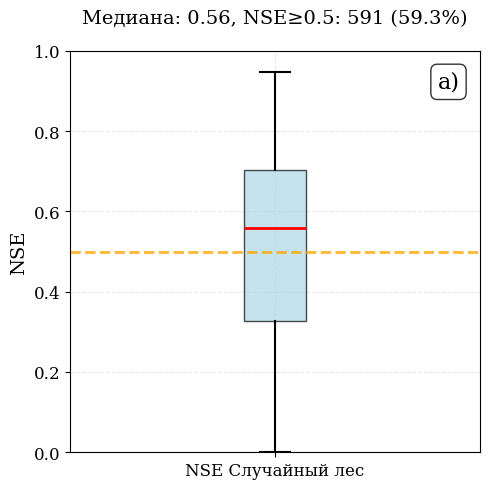

In [ ]:
rfr_geom_nse["NSE Случайный лес"].clip(lower=0, inplace=True)

# Usage example:
fig = create_nse_boxplots(
    df=rfr_geom_nse,
    nse_columns=["NSE Случайный лес"],
    figsize=(5, 5),
    color="lightblue",
    save_path="../conclusions/images/RFR_boxplots.png",  # Specify the path to save the figure,
)
plt.show()


In [ ]:
basin_districts.loc[:, ["name1", "NSE Случайный лес"]].dropna().to_csv(
    "../data/dw_tables/bo_rfr.csv", index=False
)
rfr = pd.concat([rfr_table.median().to_frame().T])
rfr.index = pd.Index(["Случайный лес"])
rfr.index.name = "Модель"
rfr.to_excel("../data/dw_tables/random_forest_statistics.xlsx", float_format="%.2f")


### LSTM-vanila, LSTM-single, LSTM-regional

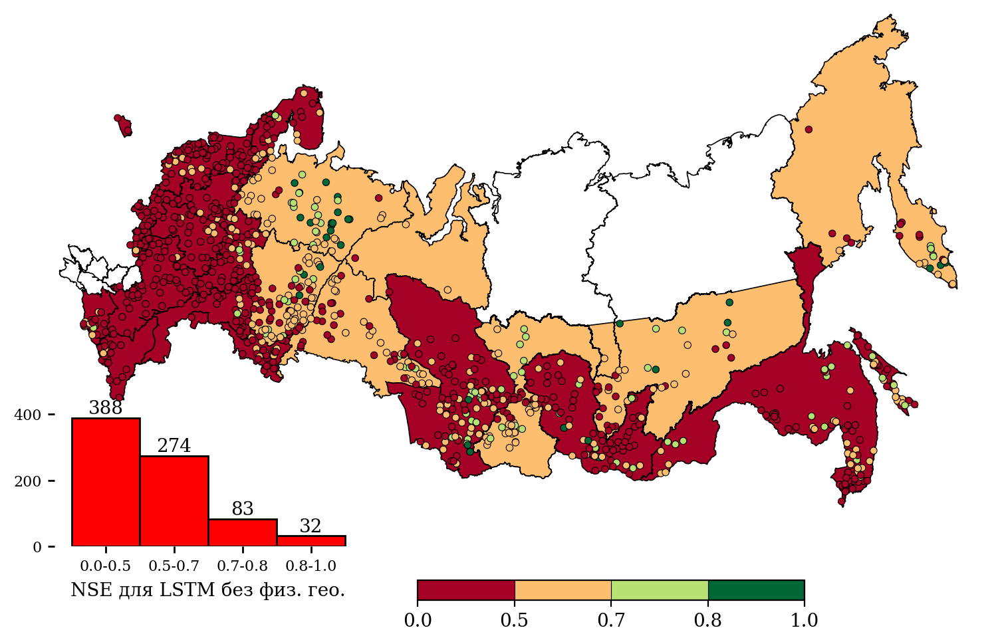

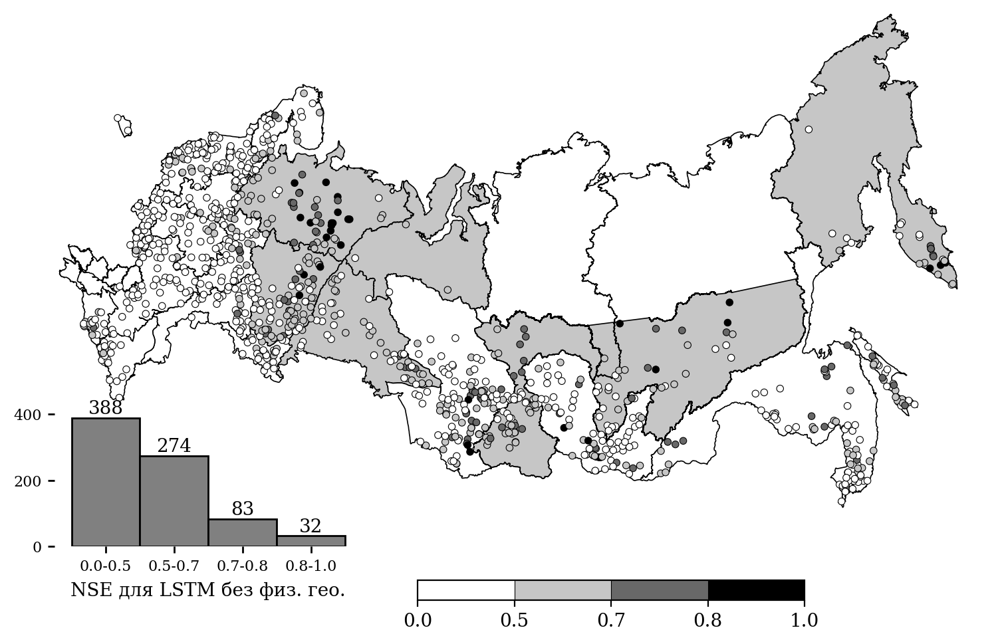

In [50]:
lstm_vanila_table, lstm_vanila_nse = read_table_gauge_str(
    table_path="../archive/conclusions/tables/LSTM_no_static_res.csv",
    index_filter=common_index,
)

lstm_vanila_geom_nse = gauges_file.loc[:, ["geometry"]]

lstm_vanila_geom_nse.loc[:, ["NSE LSTM без физ. гео."]] = pd.concat(
    [lstm_vanila_table.loc[common_index, "NSE"]],
    axis=1,
).values


for i, geom in enumerate(basin_districts["geometry"]):
    ugms_part = lstm_vanila_geom_nse.loc[
        [geom.intersects(gage_point) for gage_point in lstm_vanila_geom_nse["geometry"]],
        :,
    ]
    ugms_name = basin_districts.loc[i, "name1"]

    basin_districts.loc[i, ["NSE LSTM без физ. гео."]] = ugms_part[
        ["NSE LSTM без физ. гео."]
    ].median()

basin_districts.loc[[26, 27], ["NSE LSTM без физ. гео."]] = np.nan

mig_single_nse = russia_plots_n(
    gdf_to_plot=lstm_vanila_geom_nse,
    basemap_data=basemap_data,
    figsize=(10, 5),
    label_list=[""],
    nrows=1,
    ncols=1,
    columns_from_gdf=["NSE LSTM без физ. гео."],
    hist_name=["NSE для LSTM без физ. гео."],
    with_histogram=True,
    # title_text=[f"NSE для LSTM без физ. гео.,\nNSE = {lstm_vanila_nse:.2f}"],
    ugms=True,
    ugms_gdf=basin_districts.sort_index(),
)
mig_single_nse.savefig(
    "/Users/dmbrmv/Library/Mobile Documents/com~apple~CloudDocs/Publications/Meteorology and Hydrology/Абрамов Моделирование LSTM 2024/tiff_650//MIG_SERIES_IMAGE3.tiff",
    dpi=650,
    bbox_inches="tight",
)
mig_single_nse_grayscale = russia_plots_n(
    gdf_to_plot=lstm_vanila_geom_nse,
    basemap_data=basemap_data,
    figsize=(10, 5),
    label_list=[""],
    nrows=1,
    ncols=1,
    columns_from_gdf=["NSE LSTM без физ. гео."],
    hist_name=["NSE для LSTM без физ. гео."],
    with_histogram=True,
    cmap_name="Greys",  # Use grayscale colormap directly
    hist_facecolor="gray",
    ugms=True,
    ugms_gdf=basin_districts.sort_index(),
)
mig_single_nse_grayscale.savefig(
    "/Users/dmbrmv/Library/Mobile Documents/com~apple~CloudDocs/Publications/Meteorology and Hydrology/Абрамов Моделирование LSTM 2024/tiff_650/MIG_SERIES_IMAGE3_GRAY.tiff",
    dpi=650,
    bbox_inches="tight",
)


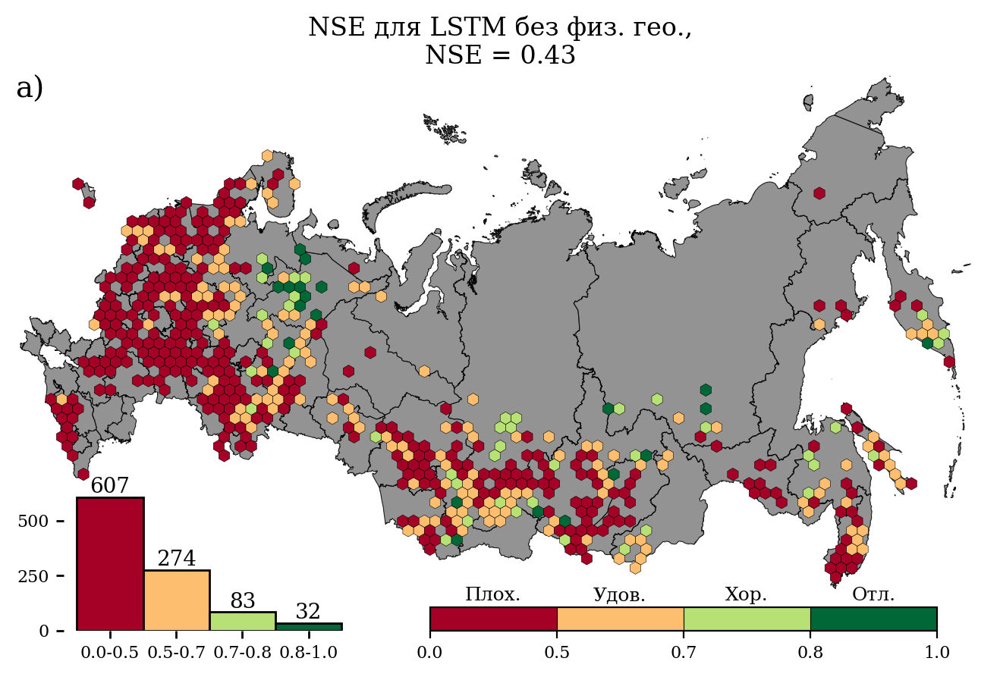

In [ ]:
ws_file["NSE LSTM без физ. гео."] = lstm_vanila_table.loc[ws_file.index, "NSE"].clip(
    lower=0
)
lstm_vanila_nse = ws_file["NSE LSTM без физ. гео."].median()
fig, hex_maps, radius_km, coverage_stats = hexes_plots_n(
    watersheds=ws_file,
    basemap_data=basemap_data,
    metric_cols=["NSE LSTM без физ. гео."],
    label_list=["а)"],
    nrows=1,
    ncols=1,
    target_ws_per_hex=4.0,
    quantile=0.5,
    list_of_limits=[0.0, 0.5, 0.7, 0.8, 1.0],
    figsize=(10, 5),
    basemap_alpha=0.85,
    with_histogram=True,
    cb_label=["Плох.", "Удов.", "Хор.", "Отл."],
    title_text=[
        f"NSE для LSTM без физ. гео.,\nNSE = {lstm_vanila_nse:.2f}",
    ],
)


In [ ]:
basin_districts.loc[:, ["name1", "NSE LSTM без физ. гео."]].dropna().to_csv(
    "../data/dw_tables/bo_lstm_no_geo.csv", index=False
)
lstm_vanila_table_stat = pd.concat([lstm_vanila_table.median().to_frame().T])
lstm_vanila_table_stat.index = pd.Index(["NSE LSTM без физ. гео."])
lstm_vanila_table_stat.index.name = "Модель"
lstm_vanila_table_stat.to_excel(
    "../data/dw_tables/lstm_no_geo_statistics.xlsx", float_format="%.2f"
)


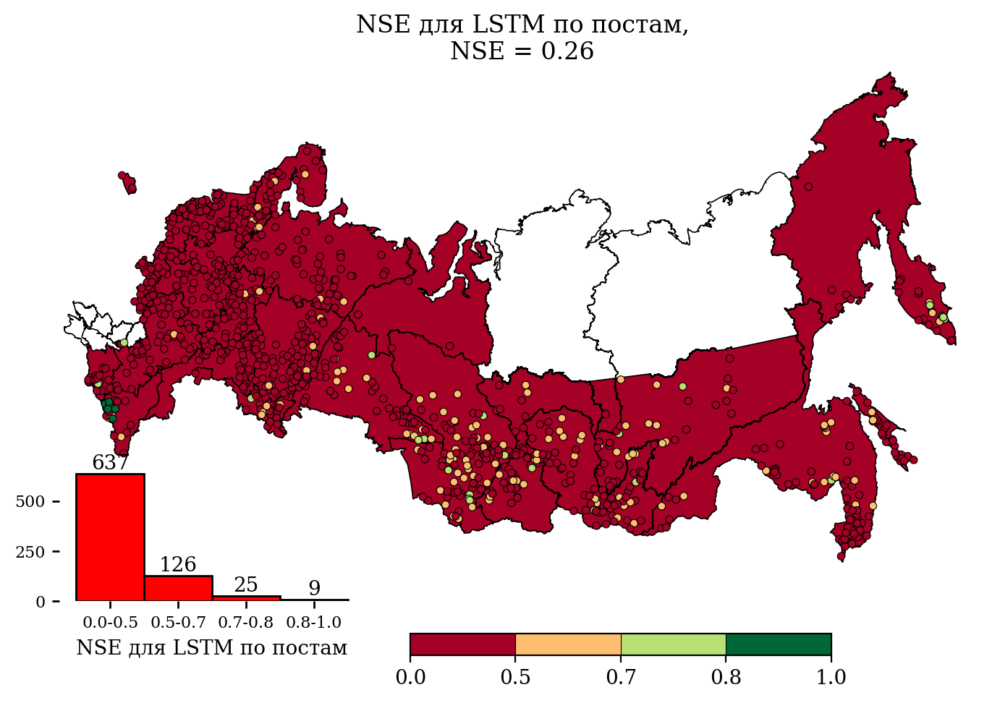

In [19]:
lstm_single_table, lstm_single_nse = read_table_gauge_str(
    table_path="../archive/conclusions/tables/Single_LSTM_table.csv",
    index_filter=common_index,
)

lstm_single_geom_nse = gauges_file.loc[:, ["geometry"]]

lstm_single_geom_nse.loc[:, ["NSE LSTM по постам"]] = pd.concat(
    [lstm_single_table.loc[common_index, "NSE"]],
    axis=1,
).values


for i, geom in enumerate(basin_districts["geometry"]):
    ugms_part = lstm_single_geom_nse.loc[
        [geom.intersects(gage_point) for gage_point in lstm_single_geom_nse["geometry"]],
        :,
    ]
    ugms_name = basin_districts.loc[i, "name1"]

    basin_districts.loc[i, ["NSE LSTM по постам"]] = ugms_part[
        ["NSE LSTM по постам"]
    ].median()

basin_districts.loc[[26, 27], ["NSE LSTM по постам"]] = np.nan

meteo_nse = russia_plots_n(
    gdf_to_plot=lstm_single_geom_nse,
    basemap_data=basemap_data,
    figsize=(10, 5),
    nrows=1,
    ncols=1,
    label_list=[""],
    columns_from_gdf=["NSE LSTM по постам"],
    hist_name=["NSE для LSTM по постам"],
    with_histogram=True,
    title_text=[f"NSE для LSTM по постам,\nNSE = {lstm_single_nse:.2f}"],
    ugms=True,
    ugms_gdf=basin_districts.sort_index(),
)


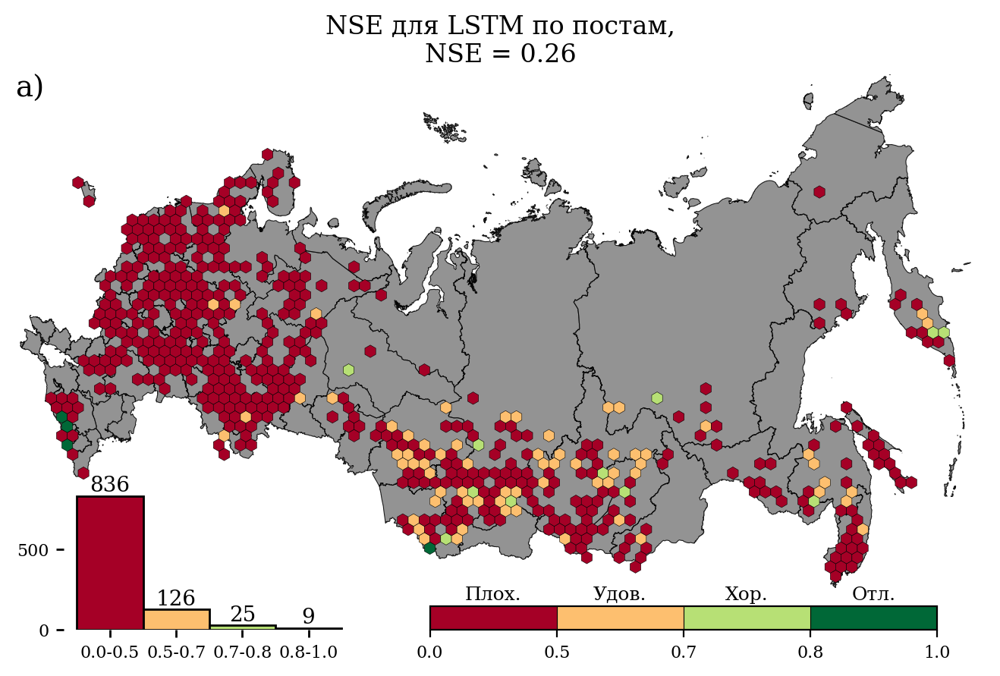

In [ ]:
ws_file["NSE LSTM по постам"] = lstm_single_table.loc[ws_file.index, "NSE"].clip(lower=0)
lstm_single_nse = ws_file["NSE LSTM по постам"].median()
fig, hex_maps, radius_km, coverage_stats = hexes_plots_n(
    watersheds=ws_file,
    basemap_data=basemap_data,
    metric_cols=["NSE LSTM по постам"],
    label_list=["а)"],
    nrows=1,
    ncols=1,
    target_ws_per_hex=4.0,
    quantile=0.5,
    list_of_limits=[0.0, 0.5, 0.7, 0.8, 1.0],
    figsize=(10, 5),
    basemap_alpha=0.85,
    with_histogram=True,
    cb_label=["Плох.", "Удов.", "Хор.", "Отл."],
    title_text=[
        f"NSE для LSTM по постам,\nNSE = {lstm_single_nse:.2f}",
    ],
)


In [ ]:
basin_districts.loc[:, ["name1", "NSE LSTM по постам"]].dropna().to_csv(
    "../data/dw_tables/bo_lstm_no_geo.csv", index=False
)
lstm_single_table_stat = pd.concat([lstm_single_table.median().to_frame().T])
lstm_single_table_stat.index = pd.Index(["NSE LSTM по постам"])
lstm_single_table_stat.index.name = "Модель"
lstm_single_table_stat.to_excel(
    "../data/dw_tables/lstm_single_statistics.xlsx", float_format="%.2f"
)


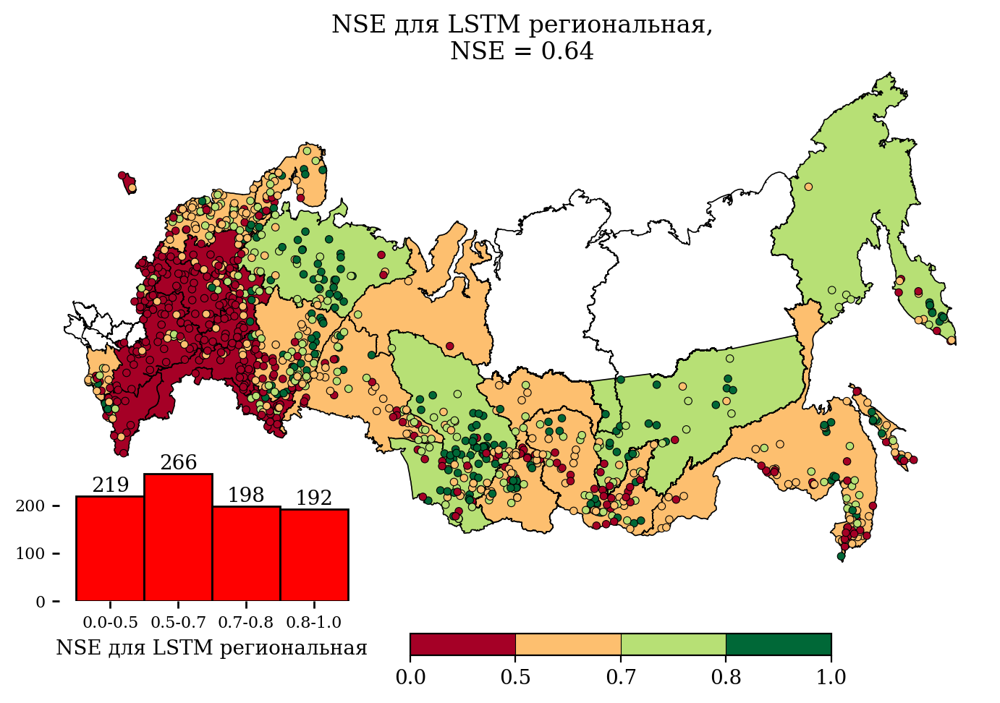

In [ ]:
lstm_regional_table, lstm_regional_nse = read_table_gauge_str(
    table_path="../conclusions/tables/cudalstm_q_mm_day_mswep_res.csv",
    index_filter=common_index,
)
common_index = common_index.intersection(lstm_regional_table.index)
lstm_regional_geom_nse = gauges_file.loc[common_index, ["geometry"]]

lstm_regional_geom_nse.loc[:, ["NSE LSTM региональная"]] = pd.concat(
    [lstm_regional_table.loc[common_index, "NSE"]],
    axis=1,
).values


for i, geom in enumerate(basin_districts["geometry"]):
    ugms_part = lstm_regional_geom_nse.loc[
        [
            geom.intersects(gage_point)
            for gage_point in lstm_regional_geom_nse["geometry"]
        ],
        :,
    ]
    ugms_name = basin_districts.loc[i, "name1"]

    basin_districts.loc[i, ["NSE LSTM региональная"]] = ugms_part[
        ["NSE LSTM региональная"]
    ].median()

basin_districts.loc[[26, 27], ["NSE LSTM региональная"]] = np.nan

meteo_nse = russia_plots_n(
    gdf_to_plot=lstm_regional_geom_nse,
    basemap_data=basemap_data,
    figsize=(10, 5),
    nrows=1,
    ncols=1,
    label_list=[""],
    columns_from_gdf=["NSE LSTM региональная"],
    hist_name=["NSE для LSTM региональная"],
    with_histogram=True,
    title_text=[f"NSE для LSTM региональная,\nNSE = {lstm_regional_nse:.2f}"],
    ugms=True,
    ugms_gdf=basin_districts.sort_index(),
)


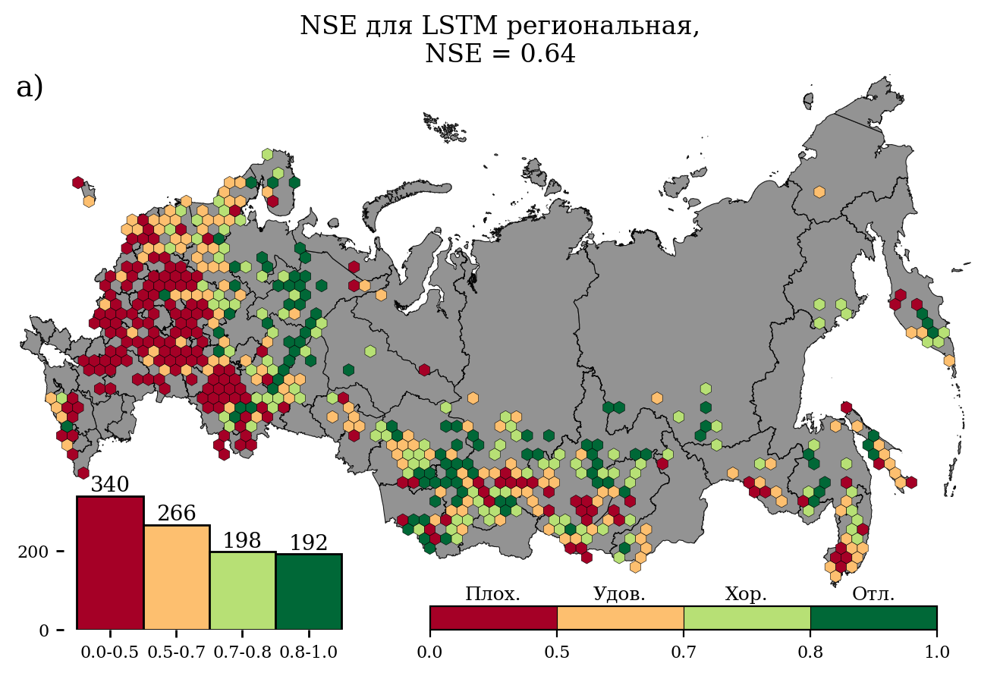

In [ ]:
ws_file["NSE LSTM региональная"] = lstm_regional_table.loc[ws_file.index, "NSE"].clip(
    lower=0
)
lstm_regional_nse = ws_file["NSE LSTM региональная"].median()
fig, hex_maps, radius_km, coverage_stats = hexes_plots_n(
    watersheds=ws_file,
    basemap_data=basemap_data,
    metric_cols=["NSE LSTM региональная"],
    label_list=["а)"],
    nrows=1,
    ncols=1,
    target_ws_per_hex=4.0,
    quantile=0.5,
    list_of_limits=[0.0, 0.5, 0.7, 0.8, 1.0],
    figsize=(10, 5),
    basemap_alpha=0.85,
    with_histogram=True,
    cb_label=["Плох.", "Удов.", "Хор.", "Отл."],
    title_text=[
        f"NSE для LSTM региональная,\nNSE = {lstm_regional_nse:.2f}",
    ],
)


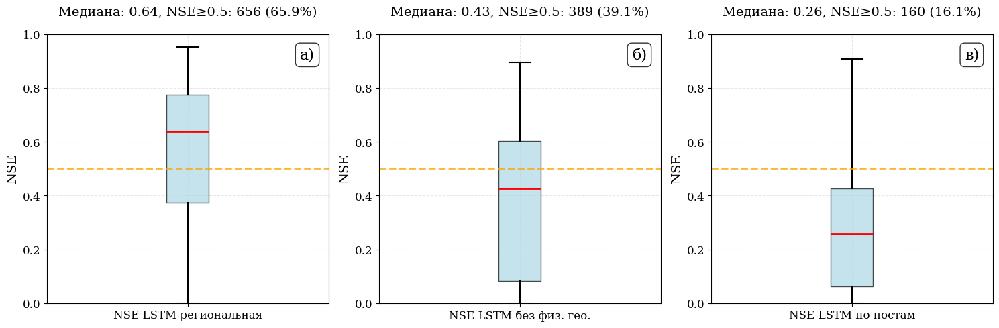

In [ ]:
lstm_boxplot = pd.concat(
    [
        lstm_regional_geom_nse[["NSE LSTM региональная"]],
        lstm_vanila_geom_nse[["NSE LSTM без физ. гео."]],
        lstm_single_geom_nse[["NSE LSTM по постам"]],
    ],
    axis=1,
)
lstm_boxplot.clip(lower=0, inplace=True)

# Usage example:
fig = create_nse_boxplots(
    df=lstm_boxplot,
    nse_columns=[
        "NSE LSTM региональная",
        "NSE LSTM без физ. гео.",
        "NSE LSTM по постам",
    ],
    max_cols=3,
    figsize=(15, 5),
    color="lightblue",
    save_path="../conclusions/images/LSTM_boxplots.png",  # Specify the path to save the figure,
)
plt.show()

In [ ]:
basin_districts.loc[:, ["name1", "NSE LSTM региональная"]].dropna().to_csv(
    "../data/dw_tables/bo_lstm_regional.csv", index=False
)
lstm_regional_table_stat = pd.concat([lstm_regional_table.median().to_frame().T])
lstm_regional_table_stat.index = pd.Index(["NSE LSTM региональная"])
lstm_regional_table_stat.index.name = "Модель"
lstm_regional_table_stat.to_excel(
    "../data/dw_tables/lstm_regional_statistics.xlsx", float_format="%.2f"
)


In [ ]:
lstm_s = pd.concat(
    [
        lstm_regional_table.median().to_frame().T,
        lstm_single_table.median().to_frame().T,
        lstm_vanila_table.median().to_frame().T,
    ]
)

lstm_s.index = pd.Index(["LSTM региональная", "LSTM по постам", "LSTM без физ. гео."])
lstm_s.index.name = "Модель"
lstm_s.to_csv("../data/dw_tables/lstm_s_statistics.csv", float_format="%.2f")


### LSTM-ERA5, LSTM-MSWEP, LSTM-ERA5-Land, LSTM-GPCP

In [14]:
lstm_geom_nse = gauges_file.loc[common_index, ["geometry"]]

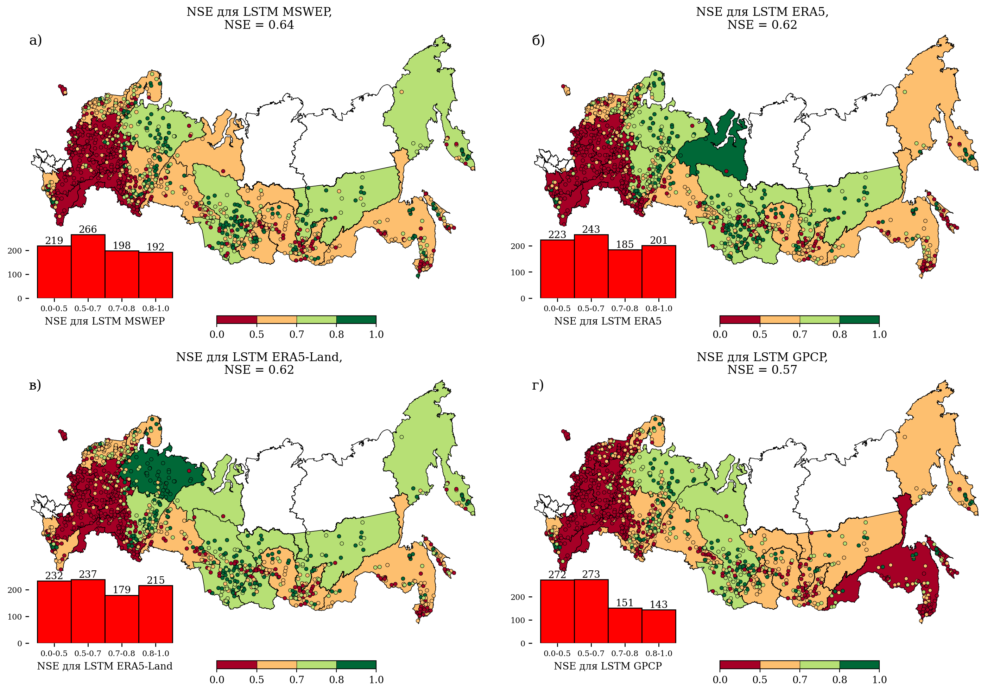

In [16]:
lstm_mswep_table, lstm_mswep_nse = read_table_gauge_str(
    table_path="../archive/conclusions/tables/cudalstm_q_mm_day_mswep_res.csv",
    index_filter=common_index,
)
lstm_era5_table, lstm_era5_nse = read_table_gauge_str(
    table_path="../archive/conclusions/tables/cudalstm_q_mm_day_era5_res.csv",
    index_filter=common_index,
)
lstm_era5_land_table, lstm_era5_land_nse = read_table_gauge_str(
    table_path="../archive/conclusions/tables/cudalstm_q_mm_day_era5l_res.csv",
    index_filter=common_index,
)
lstm_gpcp_table, lstm_gpcp_nse = read_table_gauge_str(
    table_path="../archive/conclusions/tables/cudalstm_q_mm_day_gpcp_res.csv",
    index_filter=common_index,
)
common_index = common_index.intersection(lstm_gpcp_table.index)


lstm_geom_nse.loc[
    :,
    ["NSE LSTM MSWEP", "NSE LSTM ERA5", "NSE LSTM ERA5-Land", "NSE LSTM GPCP"],
] = pd.concat(
    [
        lstm_mswep_table.loc[common_index, "NSE"],
        lstm_era5_table.loc[common_index, "NSE"],
        lstm_era5_land_table.loc[common_index, "NSE"],
        lstm_gpcp_table.loc[common_index, "NSE"],
    ],
    axis=1,
).values

for i, geom in enumerate(basin_districts["geometry"]):
    ugms_part = lstm_geom_nse.loc[
        [geom.intersects(gage_point) for gage_point in lstm_geom_nse["geometry"]],
        :,
    ]
    ugms_name = basin_districts.loc[i, "name1"]

    basin_districts.loc[
        i,
        [
            "NSE LSTM MSWEP",
            "NSE LSTM ERA5",
            "NSE LSTM ERA5-Land",
            "NSE LSTM GPCP",
        ],
    ] = ugms_part[
        [
            "NSE LSTM MSWEP",
            "NSE LSTM ERA5",
            "NSE LSTM ERA5-Land",
            "NSE LSTM GPCP",
        ]
    ].median()

basin_districts.loc[
    [26, 27],
    ["NSE LSTM MSWEP", "NSE LSTM ERA5", "NSE LSTM ERA5-Land", "NSE LSTM GPCP"],
] = np.nan

meteo_nse = russia_plots_n(
    gdf_to_plot=lstm_geom_nse,
    basemap_data=basemap_data,
    figsize=(15, 10),
    nrows=2,
    ncols=2,
    label_list=["а)", "б)", "в)", "г)"],
    columns_from_gdf=[
        "NSE LSTM MSWEP",
        "NSE LSTM ERA5",
        "NSE LSTM ERA5-Land",
        "NSE LSTM GPCP",
    ],
    hist_name=[
        "NSE для LSTM MSWEP",
        "NSE для LSTM ERA5",
        "NSE для LSTM ERA5-Land",
        "NSE для LSTM GPCP",
    ],
    with_histogram=True,
    title_text=[
        f"NSE для LSTM MSWEP,\nNSE = {lstm_mswep_nse:.2f}",
        f"NSE для LSTM ERA5,\nNSE = {lstm_era5_nse:.2f}",
        f"NSE для LSTM ERA5-Land,\nNSE = {lstm_era5_land_nse:.2f}",
        f"NSE для LSTM GPCP,\nNSE = {lstm_gpcp_nse:.2f}",
    ],
    ugms=True,
    ugms_gdf=basin_districts.sort_index(),
)


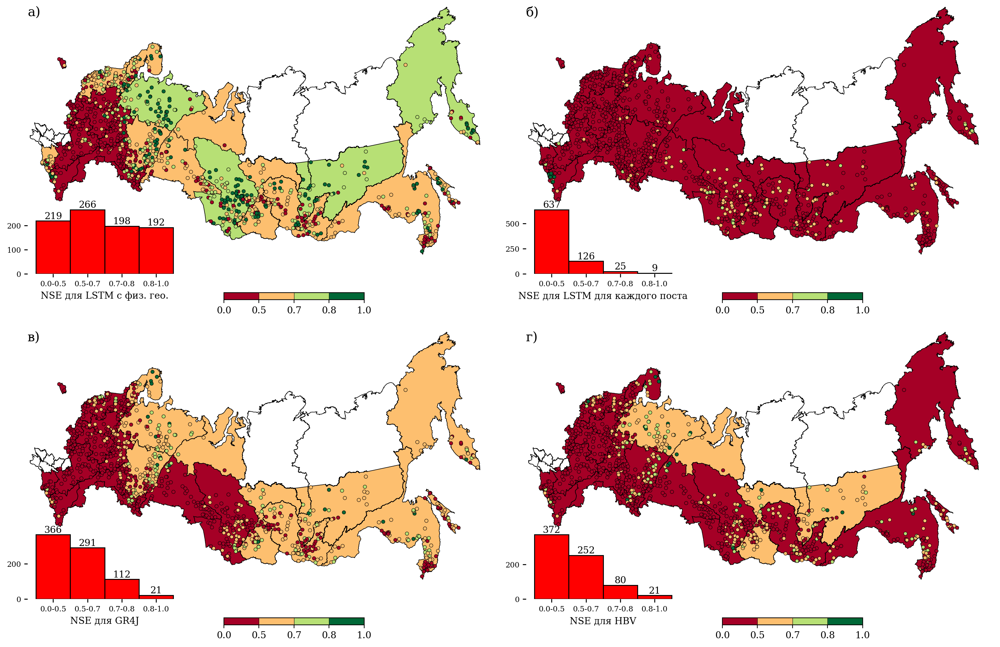

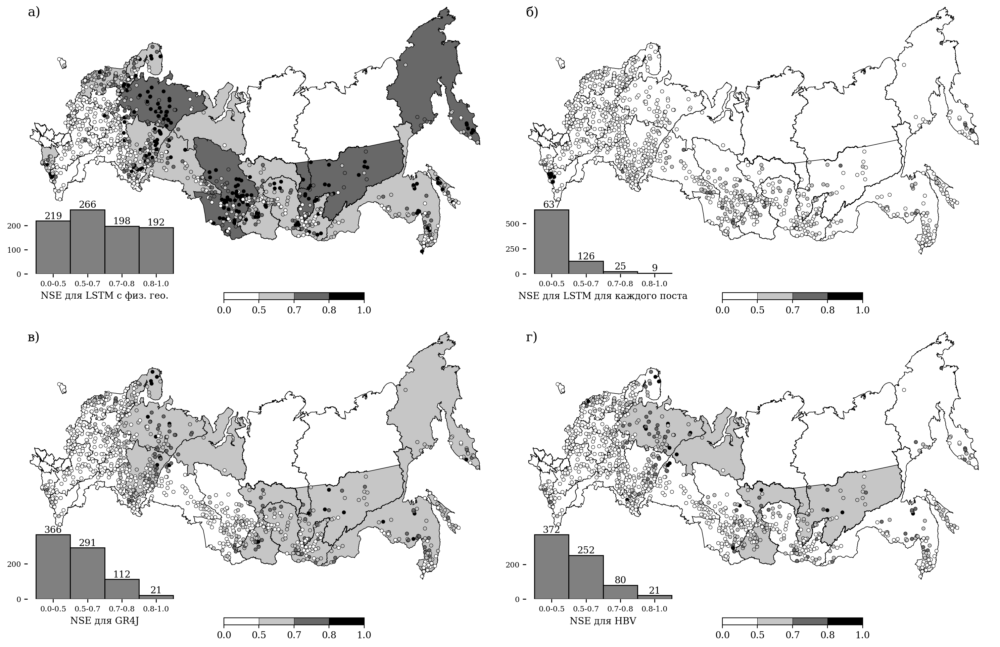

In [58]:
lstm_geom_nse.loc[
    :,
    [
        "NSE для LSTM с физ. гео.",
        "NSE для LSTM для каждого поста",
        "NSE для GR4J",
        "NSE для HBV",
    ],
] = pd.concat(
    [
        lstm_mswep_table.loc[common_index, "NSE"],
        lstm_single_table.loc[common_index, "NSE"],
        gr4j_table.loc[common_index, "NSE"],
        hbv_table.loc[common_index, "NSE"],
    ],
    axis=1,
).values

for i, geom in enumerate(basin_districts["geometry"]):
    ugms_part = lstm_geom_nse.loc[
        [geom.intersects(gage_point) for gage_point in lstm_geom_nse["geometry"]],
        :,
    ]
    ugms_name = basin_districts.loc[i, "name1"]

    basin_districts.loc[
        i,
        [
            "NSE для LSTM с физ. гео.",
            "NSE для LSTM для каждого поста",
            "NSE для GR4J",
            "NSE для HBV",
        ],
    ] = ugms_part[
        [
            "NSE для LSTM с физ. гео.",
            "NSE для LSTM для каждого поста",
            "NSE для GR4J",
            "NSE для HBV",
        ]
    ].median()

basin_districts.loc[
    [26, 27],
    [
        "NSE для LSTM с физ. гео.",
        "NSE для LSTM для каждого поста",
        "NSE для GR4J",
        "NSE для HBV",
    ],
] = np.nan

mig_nse = russia_plots_n(
    gdf_to_plot=lstm_geom_nse,
    basemap_data=basemap_data,
    figsize=(15, 10),
    nrows=2,
    ncols=2,
    label_list=[
        "а)",
        "б)",
        "в)",
        "г)",
    ],
    columns_from_gdf=[
        "NSE для LSTM с физ. гео.",
        "NSE для LSTM для каждого поста",
        "NSE для GR4J",
        "NSE для HBV",
    ],
    hist_name=[
        "NSE для LSTM с физ. гео.",
        "NSE для LSTM для каждого поста",
        "NSE для GR4J",
        "NSE для HBV",
    ],
    with_histogram=True,
    # title_text=[
    #     f"NSE для LSTM с физ. гео.,\nNSE = {lstm_mswep_nse:.2f}",
    #     f"NSE для LSTM-по постам,\nNSE = {lstm_single_nse:.2f}",
    #     f"NSE для GR4J,\nNSE = {nse_gr4j:.2f}",
    #     f"NSE для HBV,\nNSE = {nse_hbv:.2f}",
    # ],
    ugms=True,
    ugms_gdf=basin_districts,
)
mig_nse.savefig(
    "/Users/dmbrmv/Library/Mobile Documents/com~apple~CloudDocs/Publications/Meteorology and Hydrology/Абрамов Моделирование LSTM 2024/tiff_650/MIG_SERIES_IMAGE2.tiff",
    dpi=650,
    bbox_inches="tight",
)

# Grayscale version
mig_nse_grayscale = russia_plots_n(
    gdf_to_plot=lstm_geom_nse,
    basemap_data=basemap_data,
    figsize=(15, 10),
    nrows=2,
    ncols=2,
    label_list=[
        "а)",
        "б)",
        "в)",
        "г)",
    ],
    columns_from_gdf=[
        "NSE для LSTM с физ. гео.",
        "NSE для LSTM для каждого поста",
        "NSE для GR4J",
        "NSE для HBV",
    ],
    hist_name=[
        "NSE для LSTM с физ. гео.",
        "NSE для LSTM для каждого поста",
        "NSE для GR4J",
        "NSE для HBV",
    ],
    with_histogram=True,
    cmap_name="Greys",  # Grayscale colormap
    hist_facecolor="gray",  # Grayscale histogram bars
    ugms=True,
    ugms_gdf=basin_districts,
)
mig_nse_grayscale.savefig(
    "/Users/dmbrmv/Library/Mobile Documents/com~apple~CloudDocs/Publications/Meteorology and Hydrology/Абрамов Моделирование LSTM 2024/tiff_650/MIG_SERIES_IMAGE2_GRAY.tiff",
    dpi=650,
    bbox_inches="tight",
)

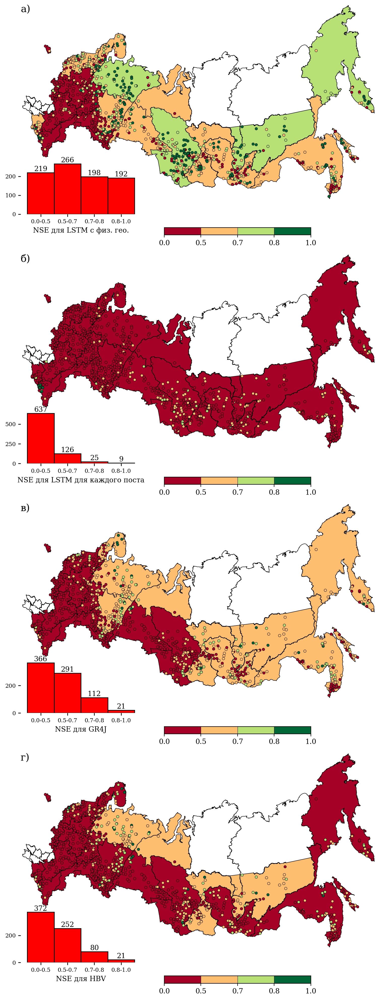

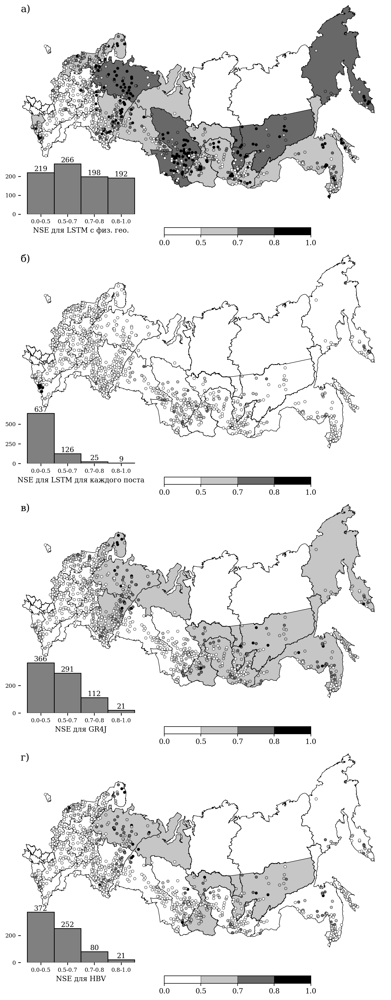

In [59]:
lstm_geom_nse.loc[
    :,
    [
        "NSE для LSTM с физ. гео.",
        "NSE для LSTM для каждого поста",
        "NSE для GR4J",
        "NSE для HBV",
    ],
] = pd.concat(
    [
        lstm_mswep_table.loc[common_index, "NSE"],
        lstm_single_table.loc[common_index, "NSE"],
        gr4j_table.loc[common_index, "NSE"],
        hbv_table.loc[common_index, "NSE"],
    ],
    axis=1,
).values

for i, geom in enumerate(basin_districts["geometry"]):
    ugms_part = lstm_geom_nse.loc[
        [geom.intersects(gage_point) for gage_point in lstm_geom_nse["geometry"]],
        :,
    ]
    ugms_name = basin_districts.loc[i, "name1"]

    basin_districts.loc[
        i,
        [
            "NSE для LSTM с физ. гео.",
            "NSE для LSTM для каждого поста",
            "NSE для GR4J",
            "NSE для HBV",
        ],
    ] = ugms_part[
        [
            "NSE для LSTM с физ. гео.",
            "NSE для LSTM для каждого поста",
            "NSE для GR4J",
            "NSE для HBV",
        ]
    ].median()

basin_districts.loc[
    [26, 27],
    [
        "NSE для LSTM с физ. гео.",
        "NSE для LSTM для каждого поста",
        "NSE для GR4J",
        "NSE для HBV",
    ],
] = np.nan

mig_nse = russia_plots_n(
    gdf_to_plot=lstm_geom_nse,
    basemap_data=basemap_data,
    figsize=(10, 20),
    nrows=4,
    ncols=1,
    label_list=[
        "а)",
        "б)",
        "в)",
        "г)",
    ],
    columns_from_gdf=[
        "NSE для LSTM с физ. гео.",
        "NSE для LSTM для каждого поста",
        "NSE для GR4J",
        "NSE для HBV",
    ],
    hist_name=[
        "NSE для LSTM с физ. гео.",
        "NSE для LSTM для каждого поста",
        "NSE для GR4J",
        "NSE для HBV",
    ],
    with_histogram=True,
    # title_text=[
    #     f"NSE для LSTM с физ. гео.,\nNSE = {lstm_mswep_nse:.2f}",
    #     f"NSE для LSTM-по постам,\nNSE = {lstm_single_nse:.2f}",
    #     f"NSE для GR4J,\nNSE = {nse_gr4j:.2f}",
    #     f"NSE для HBV,\nNSE = {nse_hbv:.2f}",
    # ],
    ugms=True,
    ugms_gdf=basin_districts,
)
mig_nse.savefig(
    "/Users/dmbrmv/Library/Mobile Documents/com~apple~CloudDocs/Publications/Meteorology and Hydrology/Абрамов Моделирование LSTM 2024/tiff_650/MIG_SERIES_IMAGE2_VERTICAL.tiff",
    dpi=650,
    bbox_inches="tight",
)

# Grayscale version
mig_nse_grayscale = russia_plots_n(
    gdf_to_plot=lstm_geom_nse,
    basemap_data=basemap_data,
    figsize=(10, 20),
    nrows=4,
    ncols=1,
    label_list=[
        "а)",
        "б)",
        "в)",
        "г)",
    ],
    columns_from_gdf=[
        "NSE для LSTM с физ. гео.",
        "NSE для LSTM для каждого поста",
        "NSE для GR4J",
        "NSE для HBV",
    ],
    hist_name=[
        "NSE для LSTM с физ. гео.",
        "NSE для LSTM для каждого поста",
        "NSE для GR4J",
        "NSE для HBV",
    ],
    with_histogram=True,
    cmap_name="Greys",  # Grayscale colormap
    hist_facecolor="gray",  # Grayscale histogram bars
    ugms=True,
    ugms_gdf=basin_districts,
)
mig_nse_grayscale.savefig(
    "/Users/dmbrmv/Library/Mobile Documents/com~apple~CloudDocs/Publications/Meteorology and Hydrology/Абрамов Моделирование LSTM 2024/tiff_650/MIG_SERIES_IMAGE2_VERTICAL_GRAY.tiff",
    dpi=650,
    bbox_inches="tight",
)


In [61]:
from PIL import Image

# Convert to grayscale and overwrite
img = Image.open(
    "/Users/dmbrmv/Library/Mobile Documents/com~apple~CloudDocs/Publications/Meteorology and Hydrology/Абрамов Моделирование LSTM 2024/tiff_650/Абрамов Моделирование LSTM 2024 рисунок 1.tiff"
)
img_grayscale = img.convert("L")  # "L" mode is grayscale
img_grayscale.save(
    "/Users/dmbrmv/Library/Mobile Documents/com~apple~CloudDocs/Publications/Meteorology and Hydrology/Абрамов Моделирование LSTM 2024/tiff_650/Абрамов Моделирование LSTM 2024 рисунок 1 чб.tiff"
)


In [ ]:
fig, hex_maps, radius_km, coverage_stats = hexes_plots_n(
    watersheds=ws_file,
    basemap_data=basemap_data,
    metric_cols=[
        "NSE LSTM региональная",
        "NSE Случайный лес",
        "NSE HBV",
        "NSE GR4J",
    ],
    label_list=["а)", "б)", "в)", "г)"],
    nrows=2,
    ncols=2,
    target_ws_per_hex=6.0,
    area_weighted=True,
    min_overlap_share=0.15,
    quantile=0.5,
    list_of_limits=[0.0, 0.5, 0.7, 0.8, 1.0],
    figsize=(15, 10),
    basemap_alpha=0.85,
    with_histogram=True,
    cb_label=["Плох.", "Удов.", "Хор.", "Отл."],
    title_text=[
        f"NSE для LSTM региональная,\nNSE = {lstm_regional_nse:.2f}",
        f"NSE для RFR,\nNSE = {rfr_nse:.2f}",
        f"NSE для HBV,\nNSE = {nse_hbv:.2f}",
        f"NSE для GR4J,\nNSE = {nse_gr4j:.2f}",
    ],
)


In [ ]:
ws_file["NSE LSTM MSWEP"] = lstm_mswep_table.loc[ws_file.index, "NSE"].clip(lower=0)
ws_file["NSE LSTM ERA5-Land"] = lstm_era5_land_table.loc[ws_file.index, "NSE"].clip(
    lower=0
)
ws_file["NSE LSTM ERA5"] = lstm_era5_table.loc[ws_file.index, "NSE"].clip(lower=0)
ws_file["NSE LSTM GPCP"] = lstm_gpcp_table.loc[ws_file.index, "NSE"].clip(lower=0)
lstm_mswep_nse = ws_file["NSE LSTM MSWEP"].median()
lstm_era5_land_nse = ws_file["NSE LSTM ERA5-Land"].median()
lstm_era5_nse = ws_file["NSE LSTM ERA5"].median()
lstm_gpcp_nse = ws_file["NSE LSTM GPCP"].median()


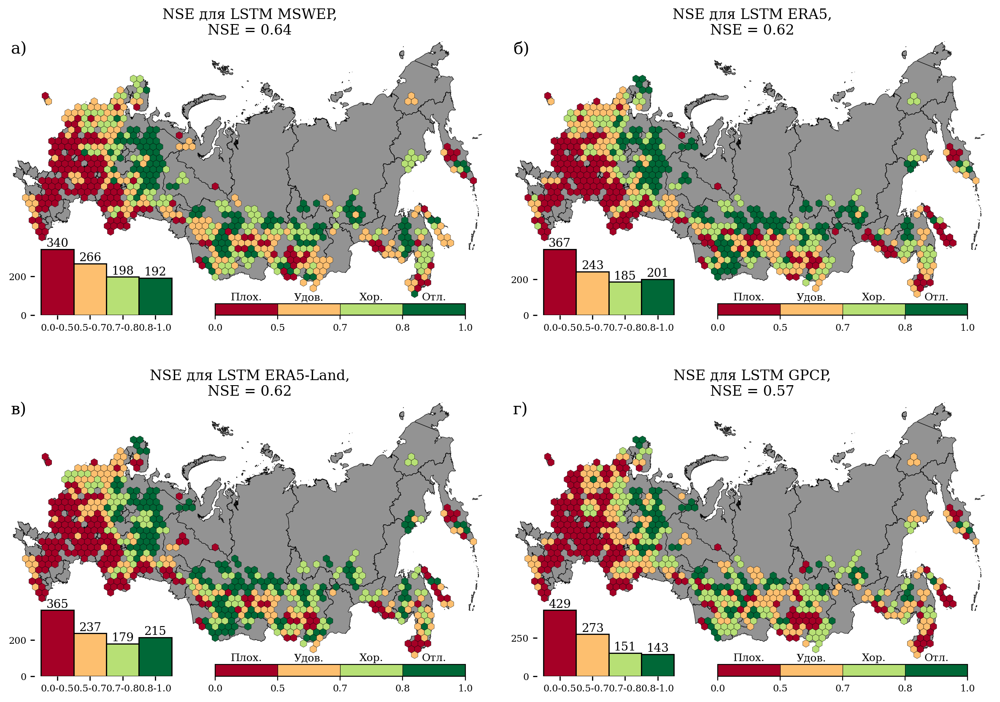

In [ ]:
fig, hex_maps, radius_km, coverage_stats = hexes_plots_n(
    watersheds=ws_file,
    basemap_data=basemap_data,
    metric_cols=[
        "NSE LSTM MSWEP",
        "NSE LSTM ERA5",
        "NSE LSTM ERA5-Land",
        "NSE LSTM GPCP",
    ],
    label_list=["а)", "б)", "в)", "г)"],
    nrows=2,
    ncols=2,
    target_ws_per_hex=6.0,
    area_weighted=True,
    min_overlap_share=0.15,
    quantile=0.5,
    list_of_limits=[0.0, 0.5, 0.7, 0.8, 1.0],
    figsize=(15, 10),
    basemap_alpha=0.85,
    with_histogram=True,
    cb_label=["Плох.", "Удов.", "Хор.", "Отл."],
    title_text=[
        f"NSE для LSTM MSWEP,\nNSE = {lstm_mswep_nse:.2f}",
        f"NSE для LSTM ERA5,\nNSE = {lstm_era5_nse:.2f}",
        f"NSE для LSTM ERA5-Land,\nNSE = {lstm_era5_land_nse:.2f}",
        f"NSE для LSTM GPCP,\nNSE = {lstm_gpcp_nse:.2f}",
    ],
)


In [ ]:
meteo_nse.savefig(
    "../data/images/Абрамов_Рис1", format="jpeg", dpi=300, bbox_inches="tight"
)


In [ ]:
basin_districts.loc[
    :,
    [
        "name1",
        "NSE LSTM MSWEP",
        "NSE LSTM ERA5",
        "NSE LSTM ERA5-Land",
        "NSE LSTM GPCP",
    ],
].dropna().to_csv("../data/dw_tables/bo_lstm_meteo_4.csv", index=False)
lstm_meteo_4_table = pd.concat(
    [
        lstm_mswep_table.loc[common_index, :].median().to_frame().T,
        lstm_era5_table.loc[common_index, :].median().to_frame().T,
        lstm_era5_land_table.loc[common_index, :].median().to_frame().T,
        lstm_gpcp_table.loc[common_index, :].median().to_frame().T,
    ]
)
lstm_meteo_4_table.index = pd.Index(
    ["NSE LSTM MSWEP", "NSE LSTM ERA5", "NSE LSTM ERA5-Land", "NSE LSTM GPCP"]
)
lstm_meteo_4_table.index.name = "Модель"
lstm_meteo_4_table.to_excel(
    "../data/dw_tables/lstm_meteo_4_statistics.xlsx", float_format="%.2f"
)


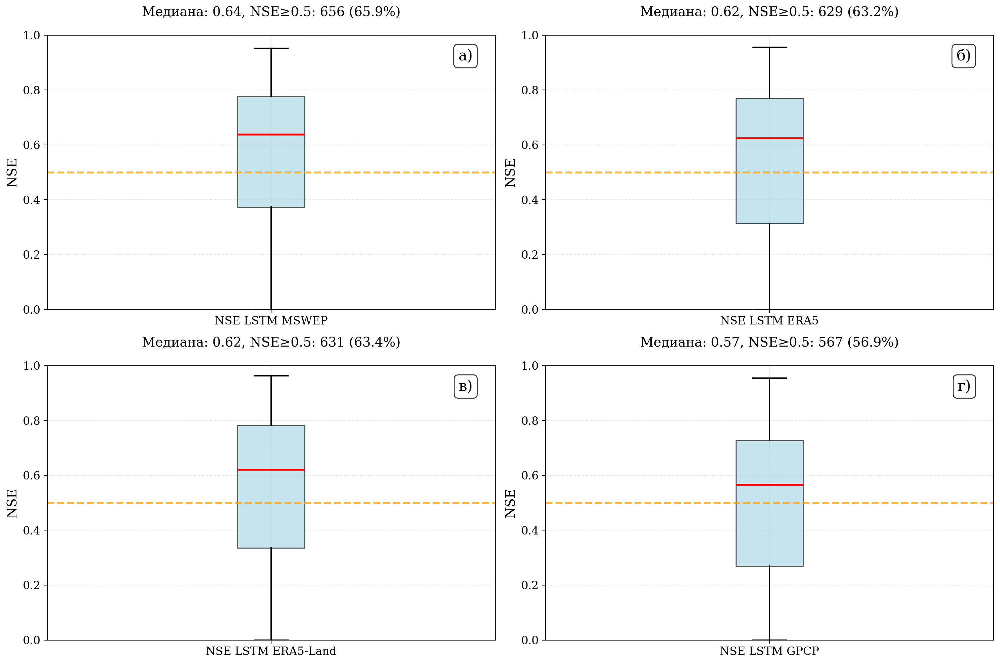

In [ ]:
lstm_meteo4_boxplot = pd.concat(
    [
        lstm_geom_nse[["NSE LSTM MSWEP"]],
        lstm_geom_nse[["NSE LSTM ERA5"]],
        lstm_geom_nse[["NSE LSTM ERA5-Land"]],
        lstm_geom_nse[["NSE LSTM GPCP"]],
    ],
    axis=1,
)
lstm_meteo4_boxplot.clip(lower=0, inplace=True)
# Usage example:
fig = create_nse_boxplots(
    df=lstm_meteo4_boxplot,
    nse_columns=[
        "NSE LSTM MSWEP",
        "NSE LSTM ERA5",
        "NSE LSTM ERA5-Land",
        "NSE LSTM GPCP",
    ],
    figsize=(15, 10),
    max_cols=2,
    color="lightblue",
    save_path="../conclusions/images/LSTM_meteo_4_boxplots.png",  # Specify the path to save the figure,
)
plt.show()

#### Get best NSE for each gauge for each meteo input

In [ ]:
lstm_geom_nse["Best Meteo NSE"] = lstm_geom_nse[
    ["NSE LSTM MSWEP", "NSE LSTM ERA5", "NSE LSTM ERA5-Land", "NSE LSTM GPCP"]
].max(axis=1)
mswep_index = lstm_geom_nse[
    lstm_geom_nse["Best Meteo NSE"].isin(lstm_geom_nse["NSE LSTM MSWEP"])
].index
era5_index = lstm_geom_nse[
    lstm_geom_nse["Best Meteo NSE"].isin(lstm_geom_nse["NSE LSTM ERA5"])
].index
era5_land_index = lstm_geom_nse[
    lstm_geom_nse["Best Meteo NSE"].isin(lstm_geom_nse["NSE LSTM ERA5-Land"])
].index
gpcp_index = lstm_geom_nse[
    lstm_geom_nse["Best Meteo NSE"].isin(lstm_geom_nse["NSE LSTM GPCP"])
].index

for name, index in {
    "MSWEP": mswep_index,
    "ERA5": era5_index,
    "ERA5-Land": era5_land_index,
    "GPCP": gpcp_index,
}.items():
    lstm_geom_nse.loc[index, "Лучшая метео модель"] = name


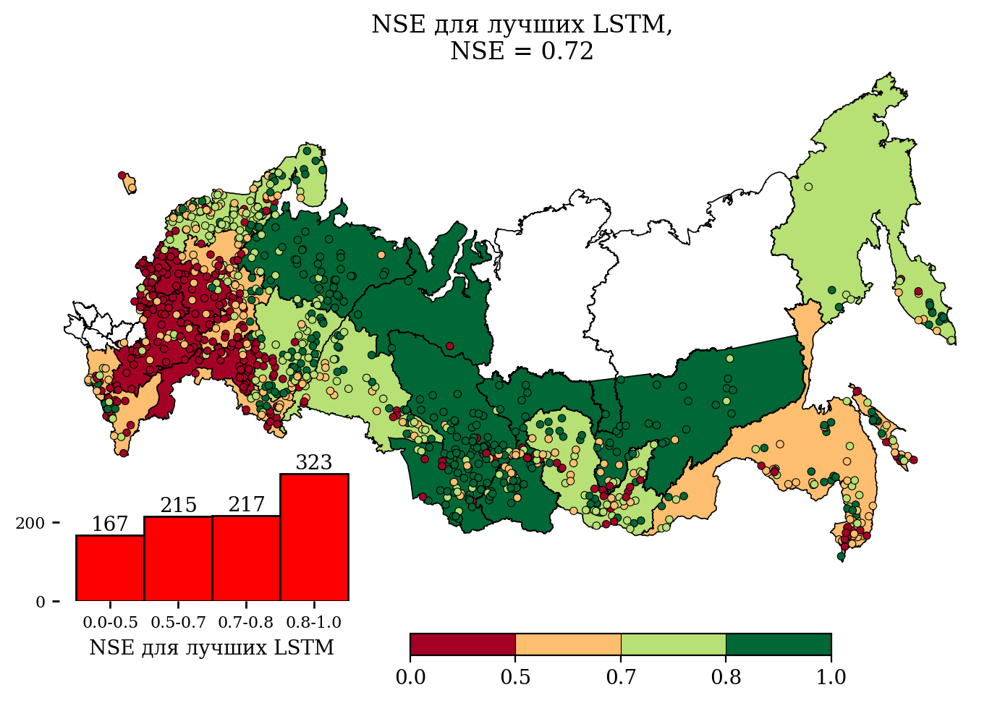

In [ ]:
for i, geom in enumerate(basin_districts["geometry"]):
    ugms_part = lstm_geom_nse.loc[
        [geom.intersects(gage_point) for gage_point in lstm_geom_nse["geometry"]],
        :,
    ]
    ugms_name = basin_districts.loc[i, "name1"]

    basin_districts.loc[i, ["Best Meteo NSE"]] = ugms_part[["Best Meteo NSE"]].median()
    lstm_geom_nse.loc[
        [geom.intersects(gage_point) for gage_point in lstm_geom_nse["geometry"]],
        "Бассейновый округ",
    ] = ugms_name

basin_districts.loc[[26, 27], ["Best Meteo NSE"]] = np.nan

meteo_nse = russia_plots_n(
    gdf_to_plot=lstm_geom_nse,
    basemap_data=basemap_data,
    figsize=(10, 5),
    nrows=1,
    ncols=1,
    label_list=[""],
    columns_from_gdf=["Best Meteo NSE"],
    hist_name=["NSE для лучших LSTM"],
    with_histogram=True,
    title_text=[
        f"NSE для лучших LSTM,\nNSE = {lstm_geom_nse['Best Meteo NSE'].median():.2f}"
    ],
    ugms=True,
    ugms_gdf=basin_districts.sort_index(),
)


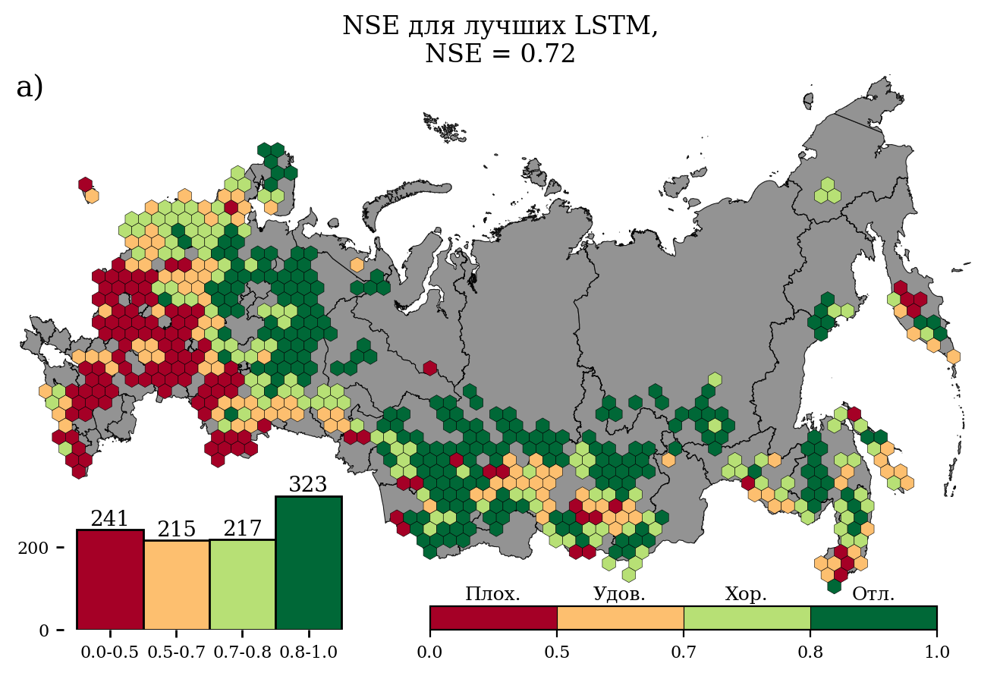

In [ ]:
ws_file["Best Meteo NSE"] = lstm_geom_nse.loc[ws_file.index, "Best Meteo NSE"].clip(
    lower=0
)
lstm_regional_nse = ws_file["Best Meteo NSE"].median()
fig, hex_maps, radius_km, coverage_stats = hexes_plots_n(
    watersheds=ws_file,
    basemap_data=basemap_data,
    metric_cols=["Best Meteo NSE"],
    label_list=["а)"],
    nrows=1,
    ncols=1,
    target_ws_per_hex=6.0,
    area_weighted=True,
    min_overlap_share=0.15,
    quantile=0.5,
    list_of_limits=[0.0, 0.5, 0.7, 0.8, 1.0],
    figsize=(10, 5),
    basemap_alpha=0.85,
    with_histogram=True,
    title_text=[
        f"NSE для лучших LSTM,\nNSE = {lstm_regional_nse:.2f}",
    ],
    cb_label=["Плох.", "Удов.", "Хор.", "Отл."],
)


In [ ]:
lstm_geom_nse.rename(columns={"Best Meteo NSE": "NSE LSTM лучший реанализ"}, inplace=True)

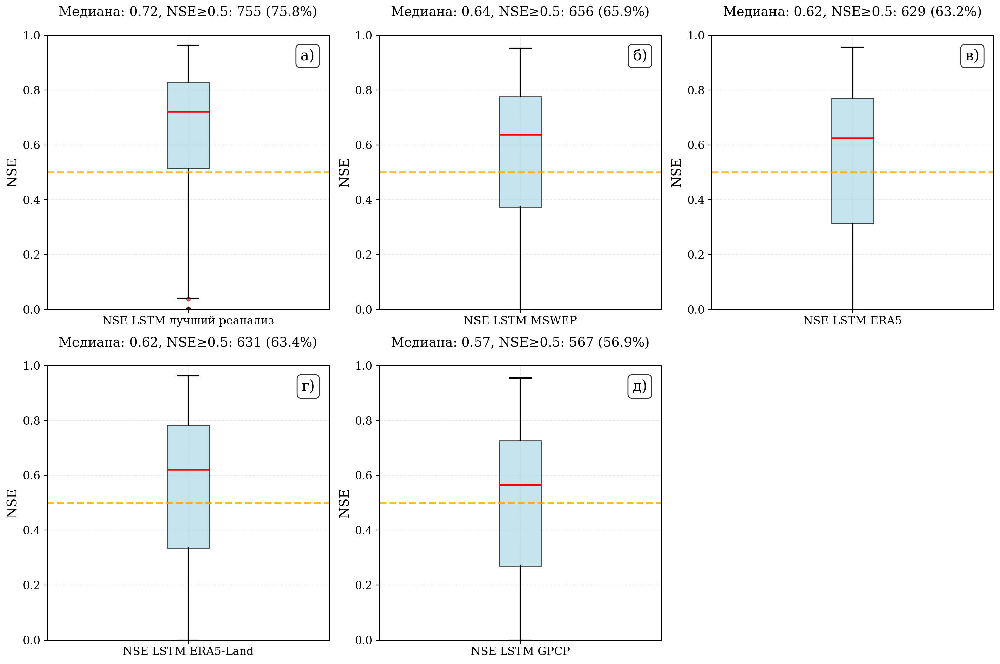

In [ ]:
lstm_meteo4_boxplot = pd.concat(
    [
        lstm_geom_nse[["NSE LSTM лучший реанализ"]],
        lstm_geom_nse[["NSE LSTM MSWEP"]],
        lstm_geom_nse[["NSE LSTM ERA5"]],
        lstm_geom_nse[["NSE LSTM ERA5-Land"]],
        lstm_geom_nse[["NSE LSTM GPCP"]],
    ],
    axis=1,
)
lstm_meteo4_boxplot.clip(lower=0, inplace=True)
# Usage example:
fig = create_nse_boxplots(
    df=lstm_meteo4_boxplot,
    nse_columns=[
        "NSE LSTM лучший реанализ",
        "NSE LSTM MSWEP",
        "NSE LSTM ERA5",
        "NSE LSTM ERA5-Land",
        "NSE LSTM GPCP",
    ],
    figsize=(15, 10),
    max_cols=3,
    color="lightblue",
    save_path="../conclusions/images/LSTM_meteo_5_boxplots.png",  # Specify the path to save the figure,
)
plt.show()


In [ ]:
lstm_meteo_4_selected = pd.concat(
    [
        lstm_mswep_table.loc[mswep_index, :].median().to_frame().T,
        lstm_era5_table.loc[era5_index, :].median().to_frame().T,
        lstm_era5_land_table.loc[era5_land_index, :].median().to_frame().T,
        lstm_gpcp_table.loc[gpcp_index, :].median().to_frame().T,
    ]
)

lstm_meteo_4_selected.index = pd.Index(
    ["NSE LSTM MSWEP", "NSE LSTM ERA5", "NSE LSTM ERA5-Land", "NSE LSTM GPCP"]
)
lstm_meteo_4_selected.index.name = "Модель"
lstm_meteo_4_selected.to_csv("../data/dw_tables/lstm_meteo_4_selected.csv")

In [ ]:
lstm_meteo_4_comp = pd.concat(
    [
        lstm_mswep_table.loc[common_index, :].median().to_frame().T,
        lstm_era5_table.loc[common_index, :].median().to_frame().T,
        lstm_era5_land_table.loc[common_index, :].median().to_frame().T,
        lstm_gpcp_table.loc[common_index, :].median().to_frame().T,
        lstm_meteo_4_selected.median().to_frame().T,
    ]
)
lstm_meteo_4_comp.index = pd.Index(
    [
        "NSE LSTM MSWEP",
        "NSE LSTM ERA5",
        "NSE LSTM ERA5-Land",
        "NSE LSTM GPCP",
        "Лучшие метео модели",
    ]
)
lstm_meteo_4_comp.index.name = "Модель"
lstm_meteo_4_comp.to_csv("../data/dw_tables/lstm_meteo_4_comp.csv")


In [ ]:
best_meteo_metrics = lstm_meteo_4_selected.median().to_frame().T


best_meteo_metrics.index = pd.Index(["Лучшие NSE модели"])
best_meteo_metrics.index.name = "Модель"
best_meteo_metrics

,NSE,KGE,r,alpha,beta,RMSE,delta
Модель,,,,,,,
Лучшие NSE модели,0.721775,0.682953,0.88102,1.12401,1.03374,0.392926,-15.044192


In [ ]:
lstm_geom_nse.loc[
    :, ["NSE LSTM лучший реанализ", "Лучшая метео модель", "Бассейновый округ"]
].to_csv("../data/dw_tables/gauge_best_meteo.csv")

In [ ]:
aea_crs = ccrs.AlbersEqualArea(
    central_longitude=100,
    standard_parallels=(50, 70),
    central_latitude=56,
    false_easting=0,
    false_northing=0,
)
aea_proj4 = aea_crs.proj4_init

watersheds_eq = to_equal_area(ws_file, crs=aea_proj4)
watersheds_eq["watershed_idx"] = watersheds_eq.index

watersheds_eq["orig_area"] = watersheds_eq.geometry.area

r_km = suggest_hex_radius(
    watersheds_eq,
    target_ws_per_hex=6,
    quantile=0.5,
    min_r_km=30,
    max_r_km=150,
    crs=aea_proj4,
)
extent_poly = box(*watersheds_eq.total_bounds)
hexes = build_hex_grid(extent_poly, r_km=r_km, crs=aea_proj4)

inter = gpd.overlay(
    watersheds_eq[["NSE LSTM MSWEP", "geometry", "orig_area"]],
    hexes.reset_index(names="hex_id"),
    how="intersection",
)
inter["a"] = inter.area
inter = inter[inter["a"] >= 0.1 * inter["orig_area"]]


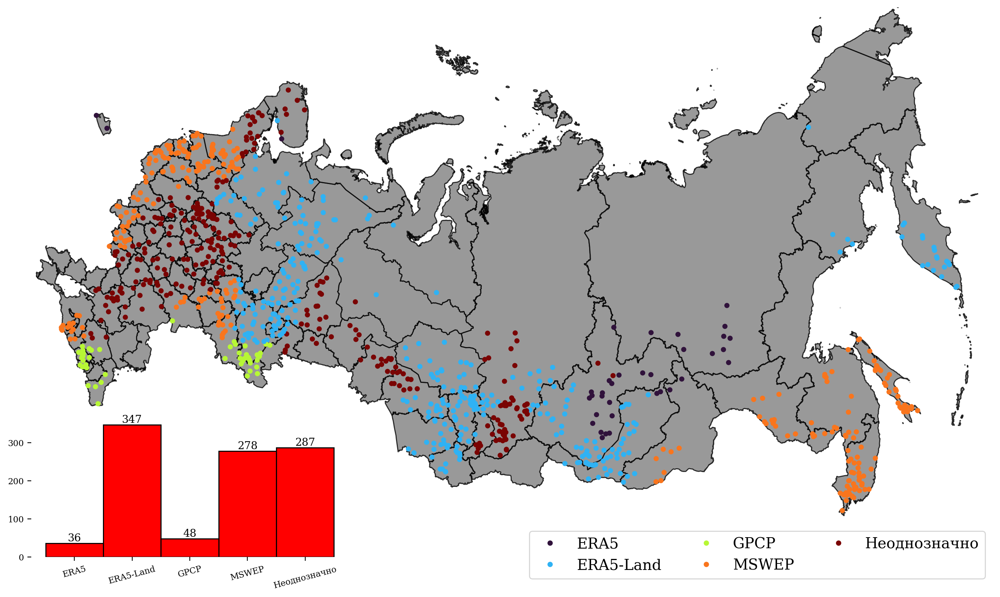

In [ ]:
gauges_fig = russia_plots(
    gdf_to_plot=lstm_geom_nse_type,
    basemap_data=basemap_data,
    distinction_col="Лучшая метео модель",
    cmap_name="turbo",
    list_of_limits=list(range(1, 5)),
    figsize=(15, 8),
    just_points=True,
    legend_cols=3,
    with_histogram=True,
)


In [ ]:
lstm_geom_nse


,geometry,NSE LSTM MSWEP,NSE LSTM ERA5,NSE LSTM ERA5-Land,NSE LSTM GPCP,NSE LSTM лучший реанализ,NSE лучший реанализ,Бассейновый округ,NSE LSTM-лучшие,NSE Cлучайный лес,NSE GR4J,NSE LSTM без физ. гео.,NSE HBV,NSE LSTM-по постам,NSE лучшие модели,Лучшая гидро модель,Best Model NSE
gauge_id,,,,,,,,,,,,,,,,,
70158,POINT (45.6336 60.05368),0.833943,0.820407,0.831432,0.740344,0.833943,MSWEP,Двинско-Печорский,0.833943,0.302832,-0.013992,0.669211,-0.362178,0.255112,0.833943,LSTM региональная,0.833943
8290,POINT (97.38294 58.03246),0.847587,0.850689,0.871560,0.833061,0.871560,ERA5-Land,Ангаро-Байкальский,0.871560,0.673733,0.603910,0.221974,0.506780,0.378174,0.871560,LSTM региональная,0.871560
70583,POINT (39.27252 59.99077),0.525068,0.624427,0.625878,0.439023,0.625878,ERA5-Land,Двинско-Печорский,0.625878,0.441214,0.636477,0.615699,0.473353,0.200950,0.636477,GR4J,0.636477
76408,POINT (59.67519 55.17181),0.542724,0.306889,0.233973,0.446993,0.542724,MSWEP,Камский,0.542724,0.172953,0.296534,0.400678,0.289450,0.008584,0.542724,LSTM региональная,0.542724
72668,POINT (29.14565 56.50485),0.757252,0.580494,0.641525,0.479778,0.757252,MSWEP,Балтийский,0.757252,0.517773,0.118087,0.510732,-0.014852,0.282443,0.757252,LSTM региональная,0.757252
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10584,POINT (88.32491 55.7643),0.359196,0.263809,0.361511,-0.580998,0.361511,ERA5-Land,Верхнеобский,0.361511,0.508236,0.106616,-0.286978,0.307496,-0.113955,0.508236,Случайный лес,0.508236
72577,POINT (28.59289 59.38333),0.815723,0.742813,0.823620,0.620366,0.823620,ERA5-Land,Балтийский,0.823620,0.687302,0.700775,0.393799,0.527647,0.311215,0.823620,LSTM региональная,0.823620
8347,POINT (98.66463 55.53709),0.411140,0.463229,0.329005,0.344148,0.463229,ERA5,Ангаро-Байкальский,0.463229,0.587596,0.053825,0.213861,0.114291,0.308333,0.587596,Случайный лес,0.587596


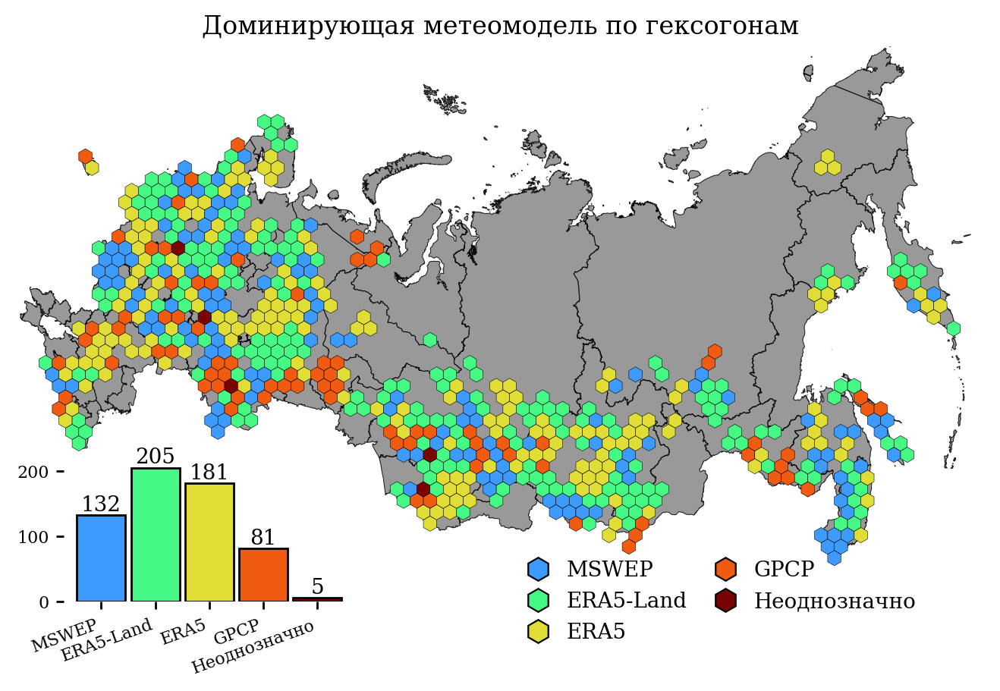

In [ ]:
from visualizations.scripts.hex_maps import hex_model_distribution_plot

ws_file.loc[common_index, ["Лучшая метео модель"]] = lstm_geom_nse.loc[
    :, ["Лучшая метео модель"]
]

cond_ws = ws_file[["geometry", "Лучшая метео модель"]]

model_dict = {
    "MSWEP": 1.0,
    "ERA5-Land": 2.0,
    "ERA5": 3.0,
    "GPCP": 4.0,
    "Неоднозначно": 5.0,
    np.nan: np.nan,
}

fig, ax, hexes_gdf, counts = hex_model_distribution_plot(
    cond_ws,
    basemap_data,
    model_col="Лучшая метео модель",
    model_dict=model_dict,
    min_overlap_share=0.15,
    dominant_threshold=0.33,
    target_ws_per_hex=6,
    skip_colors=1,  # drop the first turbo swatch
    legend_kwargs={"loc": "lower left", "bbox_to_anchor": (0.50, -0.05)},
    histogram_label_rotation=20,
    title="Доминирующая метеомодель по гексогонам",
)


In [ ]:
import xarray as xr

with xr.open_dataset("/home/dmbrmv/Development/Dissertation/data/nc_all_q/1151.nc") as f:
    pass

f[["prcp_e5l", "prcp_e5", "prcp_gpcp", "prcp_mswep"]]

<xarray.Dataset> Size: 190kB
Dimensions:     (date: 4749)
Coordinates:
  * date        (date) datetime64[ns] 38kB 2008-01-01 2008-01-02 ... 2020-12-31
    gauge_id    <U4 16B ...
Data variables:
    prcp_e5l    (date) float64 38kB ...
    prcp_e5     (date) float64 38kB ...
    prcp_gpcp   (date) float64 38kB ...
    prcp_mswep  (date) float64 38kB ...

In [ ]:
gauge_id = "71086"
list(Path("../data/nc_all_q/").rglob(f"{gauge_id}.nc"))


[PosixPath('../data/nc_all_q/71086.nc')]

In [ ]:
meteo_datasets = {}
for gauge_id in high_range_gauges:
    with xr.open_dataset(f"../data/nc_all_q/{gauge_id}.nc") as ds:
        meteo_datasets[gauge_id] = ds.load()

meteo_datasets["71086"]

<xarray.Dataset> Size: 912kB
Dimensions:     (date: 4749)
Coordinates:
  * date        (date) datetime64[ns] 38kB 2008-01-01 2008-01-02 ... 2020-12-31
    gauge_id    <U5 20B '71086'
Data variables: (12/23)
    lvl_sm      (date) float64 38kB 498.0 497.0 497.0 ... 494.0 494.0 496.0
    q_cms_s     (date) float64 38kB 27.7 26.5 26.5 26.5 ... 26.3 25.6 25.6 27.2
    lvl_mbs     (date) float64 38kB 80.03 80.02 80.02 ... 79.99 79.99 80.01
    q_mm_day    (date) float64 38kB 0.5569 0.5328 0.5328 ... 0.5147 0.5469
    t_max_e5l   (date) float64 38kB -11.0 -9.745 -7.722 ... -4.216 -4.546 -3.743
    t_max_e5    (date) float64 38kB -10.99 -9.717 -7.698 ... -4.534 -3.738
    ...          ...
    SMroot      (date) float64 38kB 0.04032 0.04031 0.0403 ... 0.03714 0.03714
    Ew          (date) float64 38kB 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0 0.0
    Ei          (date) float64 38kB 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0 0.0
    S           (date) float64 38kB 0.568 0.568 0.568 ... 0.568 0.568 0.568
    E           (date) float64 38kB -0.03179 -0.03584 ... -0.02772 -0.03642
    Ep          (date) float64 38kB -0.03179 -0.03584 ... -0.02772 -0.03642

In [ ]:
meteo_datasets["71086"].to_dataframe()


,lvl_sm,q_cms_s,lvl_mbs,q_mm_day,t_max_e5l,t_max_e5,t_min_e5l,t_min_e5,prcp_e5l,prcp_e5,...,Es,Et,SMsurf,SMroot,Ew,Ei,S,E,Ep,gauge_id
date,,,,,,,,,,,,,,,,,,,,,
2008-01-01,498.0,27.7,80.03,0.556907,-10.998234,-10.989374,-16.063695,-16.039349,0.014706,0.123427,...,-0.031790,0.0,0.040446,0.040322,0.0,0.0,0.568043,-0.031790,-0.031790,71086
2008-01-02,497.0,26.5,80.02,0.532781,-9.745302,-9.716515,-13.335993,-13.295555,0.092575,0.777297,...,-0.035840,0.0,0.040424,0.040312,0.0,0.0,0.568043,-0.035840,-0.035840,71086
2008-01-03,497.0,26.5,80.02,0.532781,-7.722011,-7.697531,-11.212827,-11.203356,0.126776,1.031209,...,-0.036669,0.0,0.040403,0.040303,0.0,0.0,0.568043,-0.036669,-0.036669,71086
2008-01-04,497.0,26.5,80.02,0.532781,-7.983771,-7.972003,-11.414432,-11.396708,0.050271,0.404696,...,-0.042574,0.0,0.040385,0.040295,0.0,0.0,0.568043,-0.042574,-0.042574,71086
2008-01-05,497.0,26.2,80.02,0.526750,-11.370166,-11.346705,-14.774957,-14.742189,0.014740,0.120650,...,-0.067393,0.0,0.040369,0.040288,0.0,0.0,0.568043,-0.067393,-0.067393,71086
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-12-27,496.0,27.2,80.01,0.546855,-14.738775,-14.767200,-30.885586,-30.939534,0.264342,2.165344,...,-0.006949,0.0,0.038211,0.037140,0.0,0.0,0.568043,-0.006949,-0.006949,71086
2020-12-28,495.0,26.3,80.00,0.528760,-5.474393,-5.472897,-13.885035,-13.907446,2.138439,17.970374,...,-0.021141,0.0,0.038211,0.037140,0.0,0.0,0.568043,-0.021141,-0.021141,71086
2020-12-29,494.0,25.6,79.99,0.514687,-4.215866,-4.209232,-5.454630,-5.451183,0.424534,3.549734,...,-0.022790,0.0,0.038211,0.037140,0.0,0.0,0.568043,-0.022790,-0.022790,71086


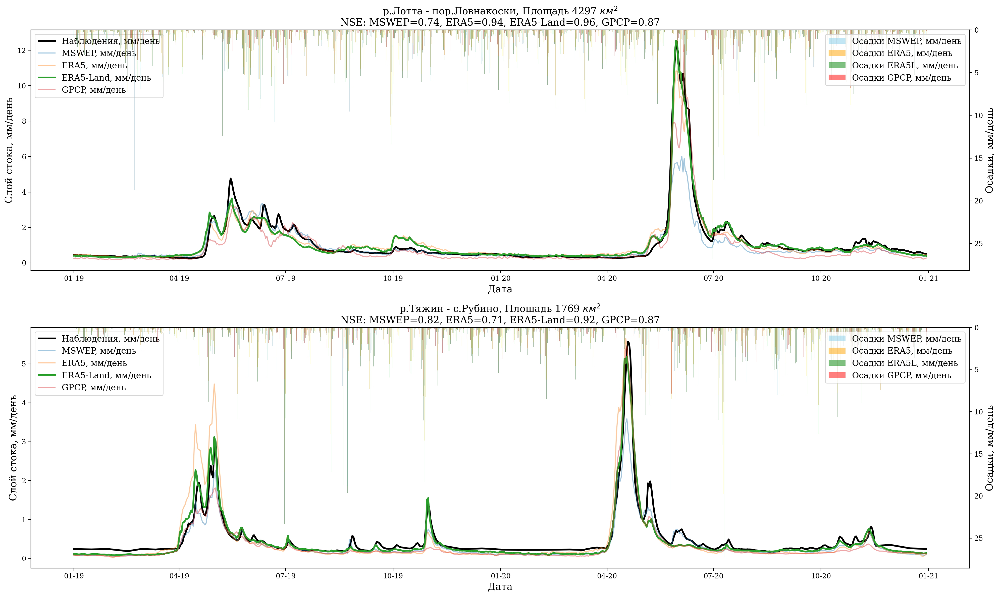

In [ ]:
with xr.open_dataset("/home/dmbrmv/Development/Dissertation/data/nc_all_q/1151.nc") as f:
    pass

f[["prcp_e5l", "prcp_e5", "prcp_gpcp", "prcp_mswep"]]

# Filter gauges where all meteo sources have NSE > 0.7
good_gauges = lstm_geom_nse[
    (lstm_geom_nse["NSE LSTM MSWEP"] > 0.7)
    & (lstm_geom_nse["NSE LSTM ERA5"] > 0.7)
    & (lstm_geom_nse["NSE LSTM ERA5-Land"] > 0.7)
    & (lstm_geom_nse["NSE LSTM GPCP"] > 0.7)
].copy()

# Calculate range (max - min) to find reasonable differences
good_gauges["meteo_range"] = good_gauges[
    ["NSE LSTM MSWEP", "NSE LSTM ERA5", "NSE LSTM ERA5-Land", "NSE LSTM GPCP"]
].max(axis=1) - good_gauges[
    ["NSE LSTM MSWEP", "NSE LSTM ERA5", "NSE LSTM ERA5-Land", "NSE LSTM GPCP"]
].min(axis=1)

# Select 2 gauges with highest range (biggest difference between meteo sources)
high_range_gauges = good_gauges.nlargest(2, "meteo_range").index

# Open meteo_datasets individually since they don't share common dimensions
meteo_datasets = {}
for gauge_id in high_range_gauges:
    with xr.open_dataset(f"../data/nc_all_q/{gauge_id}.nc") as ds:
        meteo_datasets[gauge_id] = ds.to_dataframe()

# Define pickle paths
mswep_pickle = Path(
    "../data/lstm_configs/model_runs/cudalstm_q_mm_day_mswep_no_autocorr_static_1103_191754/test/model_epoch024/test_results.p"
)
gpcp_pickle = Path(
    "../data/lstm_configs/model_runs/cudalstm_q_mm_day_gpcp_no_autocorr_static_1203_080402/test/model_epoch024/test_results.p"
)
era5l_pickle = Path(
    "../data/lstm_configs/model_runs/cudalstm_q_mm_day_era5l_no_autocorr_static_1003_133332/test/model_epoch026/test_results.p"
)
era5_pickle = Path(
    "../data/lstm_configs/model_runs/cudalstm_q_mm_day_era5_no_autocorr_static_1203_220232/test/model_epoch020/test_results.p"
)

# Load all pickle files
mswep_data = pd.read_pickle(mswep_pickle)
gpcp_data = pd.read_pickle(gpcp_pickle)
era5l_data = pd.read_pickle(era5l_pickle)
era5_data = pd.read_pickle(era5_pickle)

fig, axs = plt.subplots(nrows=2, ncols=1, figsize=(20, 12))

date_form = DateFormatter("%m-%y")

for gauge_id, ax in zip(high_range_gauges, axs.flatten(), strict=False):
    # Get data from all meteo sources
    mswep_df = pd.concat(
        [
            mswep_data[f"{gauge_id}"]["1D"]["xr"].to_dataframe().droplevel(1),
            meteo_datasets[gauge_id],
        ],
        axis=1,
    ).loc["2019":, :]
    era5_df = pd.concat(
        [
            era5_data[f"{gauge_id}"]["1D"]["xr"].to_dataframe().droplevel(1),
            meteo_datasets[gauge_id],
        ],
        axis=1,
    ).loc["2019":, :]

    era5l_df = pd.concat(
        [
            era5l_data[f"{gauge_id}"]["1D"]["xr"].to_dataframe().droplevel(1),
            meteo_datasets[gauge_id],
        ],
        axis=1,
    ).loc["2019":, :]
    gpcp_df = pd.concat(
        [
            gpcp_data[f"{gauge_id}"]["1D"]["xr"].to_dataframe().droplevel(1),
            meteo_datasets[gauge_id],
        ],
        axis=1,
    ).loc["2019":, :]

    # Create combined dataframe
    draw_df = pd.DataFrame()
    draw_df.index = mswep_df.index[:-1]
    draw_df["Наблюдения, мм/день"] = mswep_df["q_mm_day_obs"].to_numpy().squeeze()[:-1]
    draw_df["MSWEP, мм/день"] = mswep_df["q_mm_day_sim"].to_numpy().squeeze()[:-1]
    draw_df["ERA5, мм/день"] = era5_df["q_mm_day_sim"].to_numpy().squeeze()[:-1]
    draw_df["ERA5-Land, мм/день"] = era5l_df["q_mm_day_sim"].to_numpy().squeeze()[:-1]
    draw_df["GPCP, мм/день"] = gpcp_df["q_mm_day_sim"].to_numpy().squeeze()[:-1]

    # Add precipitation data
    draw_df["prcp_mswep"] = mswep_df["prcp_mswep"].to_numpy().squeeze()[:-1]
    draw_df["prcp_era5"] = era5_df["prcp_e5"].to_numpy().squeeze()[:-1] / 10
    draw_df["prcp_era5l"] = era5l_df["prcp_e5l"].to_numpy().squeeze()[:-1]
    draw_df["prcp_gpcp"] = gpcp_df["prcp_gpcp"].to_numpy().squeeze()[:-1]

    # Get NSE values
    nse_mswep = lstm_mswep_table.loc[gauge_id, "NSE"]
    nse_era5 = lstm_era5_table.loc[gauge_id, "NSE"]
    nse_era5l = lstm_era5_land_table.loc[gauge_id, "NSE"]
    nse_gpcp = lstm_gpcp_table.loc[gauge_id, "NSE"]

    # Find best NSE
    nse_dict = {
        "MSWEP, мм/день": nse_mswep,
        "ERA5, мм/день": nse_era5,
        "ERA5-Land, мм/день": nse_era5l,
        "GPCP, мм/день": nse_gpcp,
    }
    best_model = max(nse_dict, key=nse_dict.get)

    # Create secondary axis for precipitation
    ax2 = ax.twinx()

    # Plot precipitation bars for each source (inverted)
    bar_width = 0.2
    precip_colors = {
        "prcp_mswep": "skyblue",
        "prcp_era5": "orange",
        "prcp_era5l": "green",
        "prcp_gpcp": "red",
    }

    for i, (prcp_col, color) in enumerate(precip_colors.items()):
        offset = (i - 1.5) * bar_width
        ax2.bar(
            draw_df.index + pd.Timedelta(days=offset),
            draw_df[prcp_col],
            color=color,
            alpha=0.5,
            width=bar_width,
            label=f"Осадки {prcp_col.replace('prcp_', '').upper()}, мм/день",
        )

    ax2.invert_yaxis()
    ax2.set_ylabel("Осадки, мм/день", fontdict={"size": 14})

    # Plot observations (bold)
    ax.plot(
        draw_df.index,
        draw_df["Наблюдения, мм/день"],
        linewidth=2.5,
        label="Наблюдения, мм/день",
        color="black",
    )

    # Plot model predictions with different styles
    for col in [
        "MSWEP, мм/день",
        "ERA5, мм/день",
        "ERA5-Land, мм/день",
        "GPCP, мм/день",
    ]:
        if col == best_model:
            ax.plot(
                draw_df.index,
                draw_df[col],
                linewidth=2.5,
                label=col,
                alpha=1.0,
            )
        else:
            ax.plot(
                draw_df.index,
                draw_df[col],
                linewidth=1.5,
                label=col,
                alpha=0.4,
            )

    ax.set_title(
        f"{gauges_file.loc[gauge_id, 'name_ru']}, Площадь {gauges_file.loc[gauge_id, 'new_area']:.0f} $км^2$\nNSE: MSWEP={nse_mswep:.2f}, ERA5={nse_era5:.2f}, ERA5-Land={nse_era5l:.2f}, GPCP={nse_gpcp:.2f}",
        fontsize=14,
    )
    ax.xaxis.set_major_formatter(date_form)
    ax.set_ylabel("Слой стока, мм/день", fontdict={"size": 14})
    ax.set_xlabel("Дата", fontdict={"size": 14})
    ax.legend(loc="upper left", fontsize=12)
    ax2.legend(loc="upper right", fontsize=12)

plt.tight_layout()


In [ ]:
values = hexes_to_plot["Лучшая метео модель код"].dropna()
color_mapper = mpl.cm.ScalarMappable(norm=norm, cmap=cmap)
color_mapper.set_array([])
if not values.empty:
    bins = list_of_limits
    categories = pd.cut(values, bins=bins, include_lowest=True, right=True)
    hist_counts = categories.value_counts(sort=False)

    ax_hist = ax.inset_axes([0.05, 0.05, 0.30, 0.24])

    edges = list_of_limits
    bin_midpoints = [
        (left + right) / 2 for left, right in zip(edges[:-1], edges[1:], strict=False)
    ]
    colors = [color_mapper.to_rgba(midpoint) for midpoint in bin_midpoints]

    bars = ax_hist.bar(
        np.arange(len(hist_counts)),
        hist_counts.values,
        width=1,
        color=colors,
        edgecolor="black",
        linewidth=1,
    )
    ax_hist.bar_label(bars, fmt="%.0f")
    ax_hist.set_facecolor("white")
    ax_hist.tick_params(width=1)
    ax_hist.grid(False)

    # if hist_name is not None and idx < len(hist_name):
    #     ax_hist.set_xlabel(hist_name[idx], fontdict={"fontsize": 8}, loc="center")

    def _fmt_edge(val: float) -> str:
        val = max(val, edges[0])
        if np.isclose(val, 0.0, atol=1e-6):
            val = 0.0
        return f"{val:.1f}"

    xlbl = [
        f"{_fmt_edge(left)}-{_fmt_edge(right)}"
        for left, right in zip(edges[:-1], edges[1:], strict=False)
    ]
    if len(xlbl) > 4:
        xlbl = [lbl if not (lbl_idx % 2) else "" for lbl_idx, lbl in enumerate(xlbl)]

    ax_hist.set_xticks(np.arange(len(xlbl)))
    ax_hist.set_xticklabels(xlbl)
    ax_hist.set(frame_on=False)

    plt.setp(ax_hist.get_xticklabels(), fontsize=8)
    plt.setp(ax_hist.get_yticklabels(), fontsize=8)

In [ ]:
ws_file[["name_ru", "name_en", "new_area", "ais_dif", "geometry"]].to_file(
    "../data/geometry/full_ws.gpkg", driver="GPKG"
)

In [ ]:
hexes_to_plot.to_crs(wgs_proj).dropna().to_file(
    "../data/geometry/hex_GRID_meteo.gpkg", driver="GPKG"
)

In [ ]:
# Keep only the model(s) with maximal counts per hex
top = (
    counts.sort_values(["hex_idx", "count"], ascending=[True, False])
    .groupby("hex_idx", as_index=False)
    .head(1)
)

# Identify ties (multiple models share the max count)
tie_hexes = counts.groupby("hex_idx")["count"].apply(lambda x: (x == x.max()).sum() > 1)

# Build final categorical assignment
hex_model = hex_grid["hex_idx"].map(top.set_index("hex_idx")["Лучшая метео модель"])
hex_model = hex_model.where(
    ~tie_hexes.reindex(hex_grid["hex_idx"]).fillna(False), "Неоднозначно"
)

# Attach to the hex grid
hex_grid["Лучшая метео модель"] = hex_model

# Optional numeric codes for plotting
model_dict = {
    "MSWEP": 1.0,
    "ERA5-Land": 2.0,
    "ERA5": 3.0,
    "GPCP": 4.0,
    "Неоднозначно": 5.0,
    np.nan: np.nan,
}
hex_grid["Лучшая метео модель код"] = hex_model.map(model_dict)

TypeError: Series.sort_values() takes 1 positional argument but 2 positional arguments (and 1 keyword-only argument) were given

In [ ]:
# 3. Compute hex–watershed intersections
intersections = gpd.overlay(
    hex_grid.reset_index().rename(columns={"index": "hex_idx"}),
    watersheds_eq,
    how="intersection",
)
# 4. Accumulate area covered inside each hex by each model
intersections["covered_area"] = intersections.geometry.area
area_by_model = (
    intersections.groupby(["hex_idx", "Лучшая метео модель"])["covered_area"]
    .sum()
    .reset_index()
)

# 5. Pick the model with the largest coverage share in each hex
area_by_model["share"] = area_by_model["covered_area"] / area_by_model.groupby("hex_idx")[
    "covered_area"
].transform("sum")
# 4. Accumulate area covered inside each hex by each model
intersections["covered_area"] = intersections.geometry.area
area_by_model = (
    intersections.groupby(["hex_idx", "Лучшая метео модель"])["covered_area"]
    .sum()
    .reset_index()
)

# 5. Pick the model with the largest coverage share in each hex
area_by_model["share"] = area_by_model["covered_area"] / area_by_model.groupby("hex_idx")[
    "covered_area"
].transform("sum")
top_pick = (
    area_by_model.sort_values(["hex_idx", "share"], ascending=[True, False])
    .drop_duplicates("hex_idx")
    .set_index("hex_idx")
)

# Optional: mark hexes with no dominant model (e.g. <0.33 share)
dominant_share_threshold = 0.33
top_pick["hex_model"] = np.where(
    top_pick["share"] >= dominant_share_threshold,
    top_pick["Лучшая метео модель"],
    "Неоднозначно",
)

ValueError: Grouper for 'hex_idx' not 1-dimensional

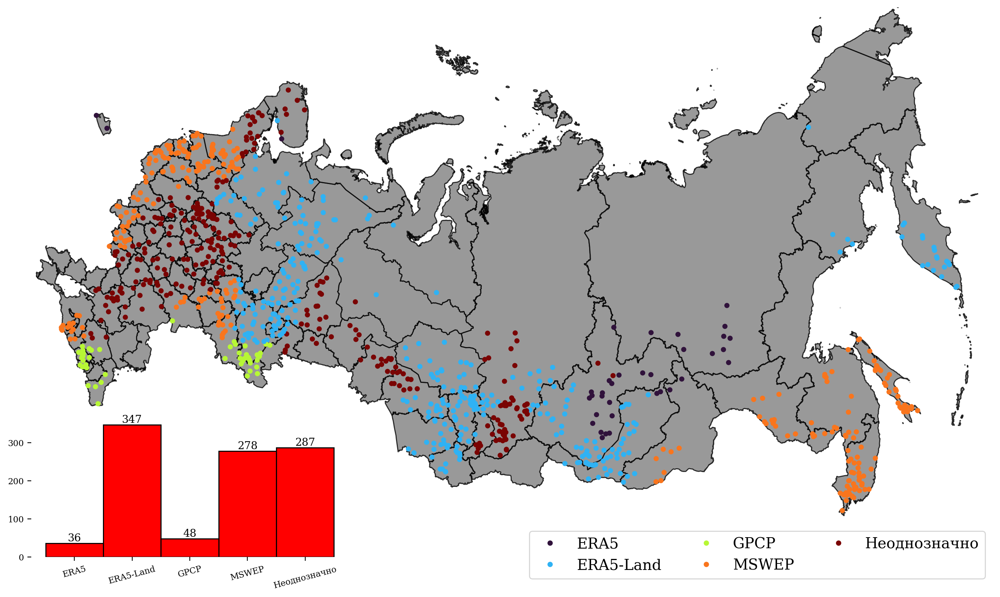

In [ ]:
lstm_geom_nse_type = deepcopy(lstm_geom_nse)

model_dict = {
    "MSWEP": 1.0,
    "ERA5-Land": 2.0,
    "ERA5": 3.0,
    "GPCP": 4.0,
    "Неоднозначно": 5.0,
    np.nan: np.nan,
}
cool_model = np.nan
for i, geom in enumerate(basin_districts["geometry"]):
    ugms_part = lstm_geom_nse_type.loc[
        [geom.intersects(gage_point) for gage_point in lstm_geom_nse_type["geometry"]],
        :,
    ]
    ugms_name = basin_districts.loc[i, "name1"]
    try:
        example = ugms_part["Лучшая метео модель"].value_counts()

        for model, value in example.items():
            if value / example.sum() > 0.33:
                cool_model = model
                break
            else:
                cool_model = "Неоднозначно"

        # basin_districts.loc[i, ["Лучшая метео модель"]] = ugms_part["Лучшая метео модель"].value_counts().index[0]
        # basin_districts.loc[i, ["Лучшая метео модель"]] = model_dict[
        #     ugms_part["Лучшая метео модель"].value_counts().index[0]
        # ]
        basin_districts.loc[i, ["Лучшая метео модель"]] = model_dict[cool_model]
        lstm_geom_nse_type.loc[
            [
                geom.intersects(gage_point)
                for gage_point in lstm_geom_nse_type["geometry"]
            ],
            ["Лучшая метео модель"],
        ] = cool_model
    except IndexError:
        basin_districts.loc[i, ["Лучшая метео модель"]] = np.nan
basin_districts.loc[[26, 27], ["Лучшая метео модель"]] = np.nan
# lstm_geom_nse_type["Лучшая метео модель"] = [model_dict[i] for i in lstm_geom_nse_type["Лучшая метео модель"]]

gauges_fig = russia_plots(
    gdf_to_plot=lstm_geom_nse_type,
    basemap_data=basemap_data,
    distinction_col="Лучшая метео модель",
    cmap_name="turbo",
    list_of_limits=list(range(1, 5)),
    figsize=(15, 8),
    just_points=True,
    legend_cols=3,
    with_histogram=True,
)


In [ ]:
gauges_fig.savefig(
    "../data/images/Абрамов_Рис2", format="jpeg", dpi=300, bbox_inches="tight"
)


In [ ]:
basin_districts["Лучшая метео модель"] = [
    {k: v for v, k in model_dict.items()}[i] if not np.isnan(i) else np.nan
    for i in basin_districts["Лучшая метео модель"]
]
basin_districts[["name1", "Лучшая метео модель"]].dropna().to_csv(
    "../data/dw_tables/best_model_33.csv"
)


In [ ]:
for i, geom in enumerate(basin_districts["geometry"]):
    ugms_part = lstm_geom_nse.loc[
        [geom.intersects(gage_point) for gage_point in lstm_geom_nse["geometry"]],
        :,
    ]
    ugms_name = basin_districts.loc[i, "name1"]

    basin_districts.loc[i, ["Best Meteo NSE"]] = ugms_part[["Best Meteo NSE"]].median()
    basin_districts.loc[i, ["Количество точек"]] = int(len(ugms_part))

basin_districts.loc[[26, 27], ["Best Meteo NSE"]] = np.nan


In [ ]:
basin_to_excel = basin_districts.drop(
    columns=[
        "path",
        "geometry",
        "NSE LSTM региональная",
        "Лучшая метео модель",
        "layer",
        "NSE LSTM MSWEP",
        "NSE LSTM ERA5",
        "NSE LSTM ERA5-Land",
        "NSE LSTM GPCP",
    ]
).dropna()

basin_to_excel = basin_to_excel.set_index("name1")
basin_to_excel.index.name = "Бассейновый округ"
basin_to_excel = basin_to_excel.loc[
    :,
    [
        "Best Meteo NSE",
        "NSE Случайный лес",
        "NSE GR4J",
        "NSE LSTM без физ. гео.",
        "NSE HBV",
        "NSE LSTM по постам",
        "Количество точек",
    ],
]
# basin_to_excel.to_excel("../conclusions/tables/nse_bys")
# apply some formatting for all numbers (optional)
df_s = basin_to_excel.style.format("{:.2f}")
# df_s = df_s.loc[:, ["Количество точек"]].style.format("{:.0f}")
# loop through rows and find which column for each row has the highest value
for row in basin_to_excel.index:
    col = basin_to_excel.loc[
        row,
        [
            "Best Meteo NSE",
            "NSE Случайный лес",
            "NSE GR4J",
            "NSE LSTM без физ. гео.",
            "NSE HBV",
            "NSE LSTM по постам",
        ],
    ].idxmax()
    # redo formatting for a specific cell
    # df_s = df_s.format(lambda x: "\\textbf{" + f"{x:.3f}" + "}", subset=(row, col))
df_s.to_excel("../data/dw_tables/NSE_by_basin_district.xlsx")


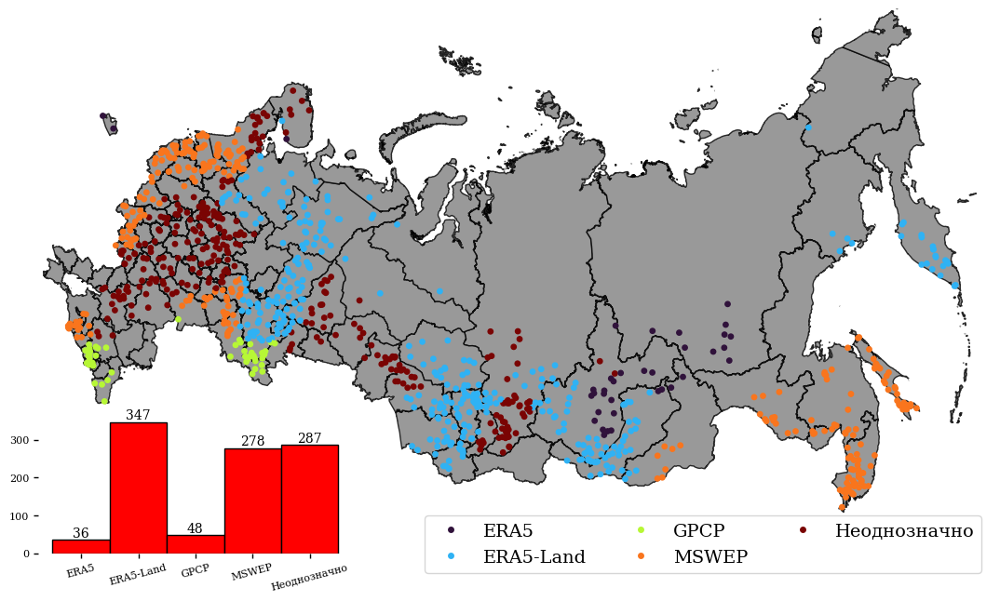

In [ ]:
lstm_geom_nse_type = deepcopy(lstm_geom_nse)

model_dict = {
    "MSWEP": 1,
    "ERA5-Land": 2,
    "ERA5": 3,
    "GPCP": 4,
    "Неоднозначно": 5,
    np.nan: np.nan,
}
cool_model = np.nan
for i, geom in enumerate(basin_districts["geometry"]):
    ugms_part = lstm_geom_nse_type.loc[
        [geom.intersects(gage_point) for gage_point in lstm_geom_nse_type["geometry"]],
        :,
    ]
    ugms_name = basin_districts.loc[i, "name1"]
    try:
        example = ugms_part["Лучшая метео модель"].value_counts()

        for model, value in example.items():
            if value / example.sum() > 0.33:
                cool_model = model
                break
            else:
                cool_model = "Неоднозначно"

        # basin_districts.loc[i, ["Лучшая метео модель"]] = ugms_part["Лучшая метео модель"].value_counts().index[0]
        # basin_districts.loc[i, ["Лучшая метео модель"]] = model_dict[
        #     ugms_part["Лучшая метео модель"].value_counts().index[0]
        # ]
        basin_districts.loc[i, ["Лучшая метео модель"]] = model_dict[cool_model]
        lstm_geom_nse_type.loc[
            [
                geom.intersects(gage_point)
                for gage_point in lstm_geom_nse_type["geometry"]
            ],
            ["Лучшая метео модель"],
        ] = cool_model
    except IndexError:
        basin_districts.loc[i, ["Лучшая метео модель"]] = np.nan
basin_districts.loc[[26, 27], ["Лучшая метео модель"]] = np.nan
# lstm_geom_nse_type["Лучшая метео модель"] = [model_dict[i] for i in lstm_geom_nse_type["Лучшая метео модель"]]

gauges_fig = russia_plots(
    gdf_to_plot=lstm_geom_nse_type,
    basemap_data=basemap_data,
    distinction_col="Лучшая метео модель",
    cmap_name="turbo",
    list_of_limits=list(range(1, 5)),
    figsize=(15, 8),
    just_points=True,
    legend_cols=3,
    with_histogram=True,
)


### HBV, GR4J, LSTM-regional, LSTM-single, LSTM-vanila, Random Forest

In [ ]:
lstm_best_table = pd.concat(
    [
        lstm_mswep_table.loc[mswep_index, :],
        lstm_era5_land_table.loc[era5_land_index, :],
        lstm_era5_table.loc[era5_index, :],
        lstm_gpcp_table.loc[gpcp_index, :],
    ]
)

lstm_s_meteo = pd.concat(
    [
        lstm_mswep_table.median().to_frame().T,
        lstm_era5_table.median().to_frame().T,
        lstm_era5_land_table.median().to_frame().T,
        lstm_gpcp_table.median().to_frame().T,
        lstm_best_table.median().to_frame().T,
    ]
)

lstm_s_meteo.index = pd.Index(
    ["LSTM MSWEP", "LSTM ERA5", "LSTM ERA5-Land", "LSTM GPCP", "Лучшие LSTM"]
)

lstm_s_meteo.to_excel(
    "../data/dw_tables/lstm_s_meteo_statistics.xlsx", float_format="%.2f"
)

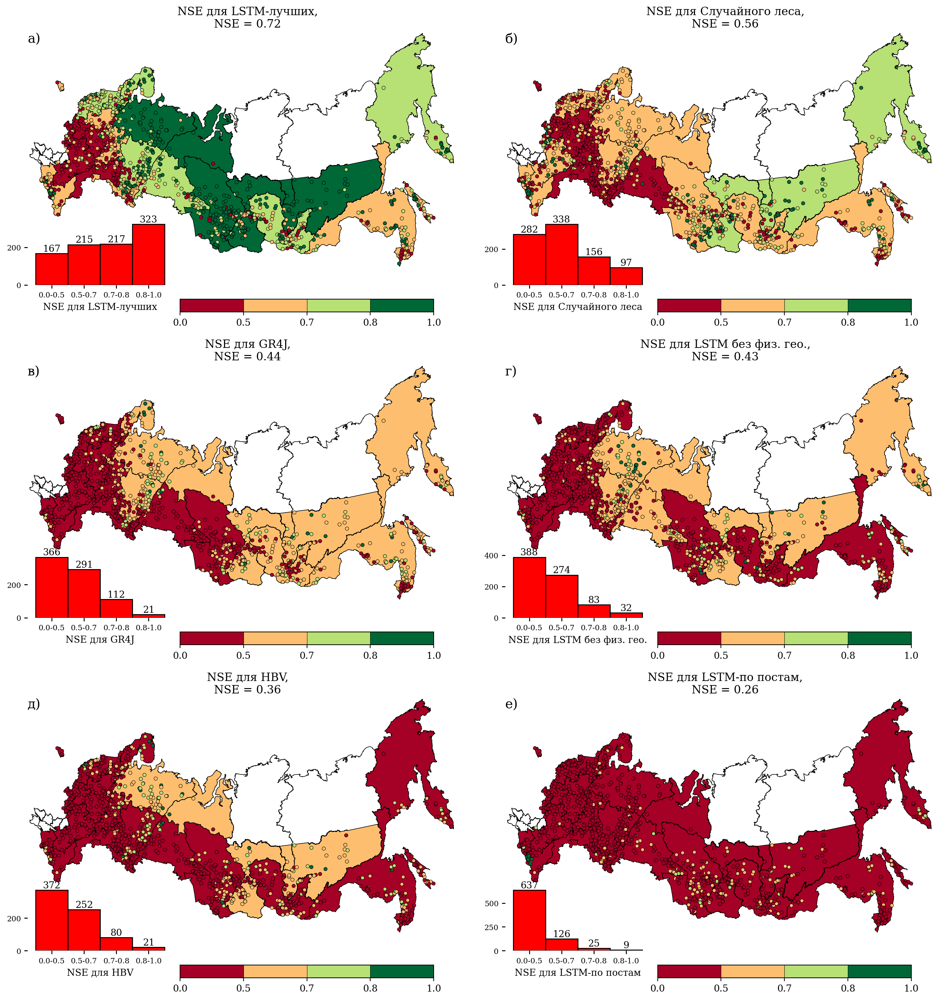

In [ ]:
# lstm_geom_nse = gauges_file.loc[common_index, ["geometry"]]
lstm_best_nse = lstm_best_table.loc[common_index, "NSE"].median()

lstm_geom_nse.loc[
    :,
    [
        "NSE LSTM-лучшие",
        "NSE Cлучайный лес",
        "NSE GR4J",
        "NSE LSTM без физ. гео.",
        "NSE HBV",
        "NSE LSTM-по постам",
    ],
] = pd.concat(
    [
        lstm_best_table.loc[common_index, "NSE"],
        rfr_table.loc[common_index, "NSE"],
        gr4j_table.loc[common_index, "NSE"],
        lstm_vanila_table.loc[common_index, "NSE"],
        hbv_table.loc[common_index, "NSE"],
        lstm_single_table.loc[common_index, "NSE"],
    ],
    axis=1,
).values

for i, geom in enumerate(basin_districts["geometry"]):
    ugms_part = lstm_geom_nse.loc[
        [geom.intersects(gage_point) for gage_point in lstm_geom_nse["geometry"]],
        :,
    ]
    ugms_name = basin_districts.loc[i, "name1"]

    basin_districts.loc[
        i,
        [
            "NSE LSTM-лучшие",
            "NSE Cлучайный лес",
            "NSE GR4J",
            "NSE LSTM без физ. гео.",
            "NSE HBV",
            "NSE LSTM-по постам",
        ],
    ] = ugms_part[
        [
            "NSE LSTM-лучшие",
            "NSE Cлучайный лес",
            "NSE GR4J",
            "NSE LSTM без физ. гео.",
            "NSE HBV",
            "NSE LSTM-по постам",
        ]
    ].median()

basin_districts.loc[
    [26, 27],
    [
        "NSE LSTM-лучшие",
        "NSE Cлучайный лес",
        "NSE GR4J",
        "NSE LSTM без физ. гео.",
        "NSE HBV",
        "NSE LSTM-по постам",
    ],
] = np.nan

meteo_nse = russia_plots_n(
    gdf_to_plot=lstm_geom_nse,
    basemap_data=basemap_data,
    figsize=(20, 15),
    nrows=3,
    ncols=2,
    label_list=["а)", "б)", "в)", "г)", "д)", "е)"],
    columns_from_gdf=[
        "NSE LSTM-лучшие",
        "NSE Cлучайный лес",
        "NSE GR4J",
        "NSE LSTM без физ. гео.",
        "NSE HBV",
        "NSE LSTM-по постам",
    ],
    hist_name=[
        "NSE для LSTM-лучших",
        "NSE для Cлучайного леса",
        "NSE для GR4J",
        "NSE для LSTM без физ. гео.",
        "NSE для HBV",
        "NSE для LSTM-по постам",
    ],
    with_histogram=True,
    title_text=[
        f"NSE для LSTM-лучших,\nNSE = {lstm_best_nse:.2f}",
        f"NSE для Cлучайного леса,\nNSE = {rfr_nse:.2f}",
        f"NSE для GR4J,\nNSE = {nse_gr4j:.2f}",
        f"NSE для LSTM без физ. гео.,\nNSE = {lstm_vanila_nse:.2f}",
        f"NSE для HBV,\nNSE = {nse_hbv:.2f}",
        f"NSE для LSTM-по постам,\nNSE = {lstm_single_nse:.2f}",
    ],
    ugms=True,
    ugms_gdf=basin_districts,
)


In [ ]:
meteo_nse.savefig(
    "../conclusions/images/AllModels.png",
    format="png",
    dpi=300,
    bbox_inches="tight",
)


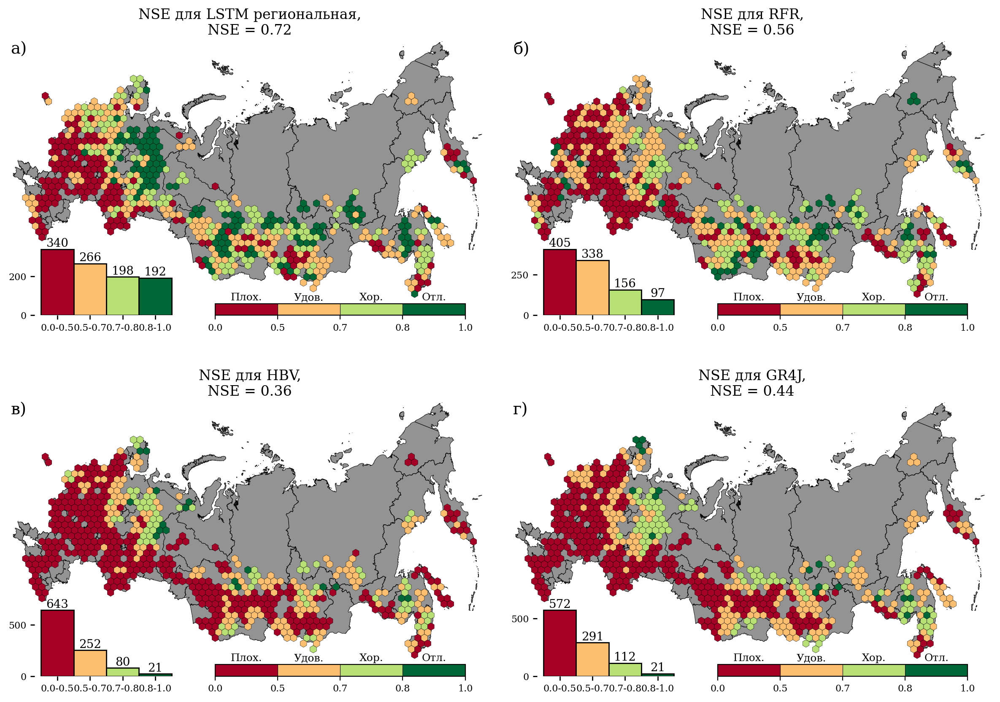

In [ ]:
fig, hex_maps, radius_km, coverage_stats = hexes_plots_n(
    watersheds=ws_file,
    basemap_data=basemap_data,
    metric_cols=[
        "NSE LSTM региональная",
        "NSE Случайный лес",
        "NSE HBV",
        "NSE GR4J",
    ],
    label_list=["а)", "б)", "в)", "г)"],
    nrows=2,
    ncols=2,
    target_ws_per_hex=6.0,
    area_weighted=True,
    min_overlap_share=0.15,
    quantile=0.5,
    list_of_limits=[0.0, 0.5, 0.7, 0.8, 1.0],
    figsize=(15, 10),
    basemap_alpha=0.85,
    with_histogram=True,
    cb_label=["Плох.", "Удов.", "Хор.", "Отл."],
    title_text=[
        f"NSE для LSTM региональная,\nNSE = {lstm_regional_nse:.2f}",
        f"NSE для RFR,\nNSE = {rfr_nse:.2f}",
        f"NSE для HBV,\nNSE = {nse_hbv:.2f}",
        f"NSE для GR4J,\nNSE = {nse_gr4j:.2f}",
    ],
)


### Best 4, Worst 4

In [ ]:
best_4 = lstm_best_table[lstm_best_table["NSE"] > 0.85].sample(n=8)

mswep_pickle = Path(
    "../data/lstm_configs/model_runs/cudalstm_q_mm_day_mswep_no_autocorr_static_1103_191754/test/model_epoch024/test_results.p"
)
gpcp_pickle = Path(
    "../data/lstm_configs/model_runs/cudalstm_q_mm_day_gpcp_no_autocorr_static_1203_080402/test/model_epoch024/test_results.p"
)
era5l_pickle = Path(
    "../data/lstm_configs/model_runs/cudalstm_q_mm_day_era5l_no_autocorr_static_1003_133332/test/model_epoch026/test_results.p"
)
era5_pickle = Path(
    "../data/lstm_configs/model_runs/cudalstm_q_mm_day_era5_no_autocorr_static_1203_220232/test/model_epoch020/test_results.p"
)

fig, axs = plt.subplots(nrows=4, ncols=2, figsize=(15, 20))

date_form = DateFormatter("%m-%y")

for gauge_id, ax in zip(best_4.index, np.ravel(axs), strict=False):
    if gauge_id in mswep_index:
        pickle_file = mswep_pickle
    elif gauge_id in gpcp_index:
        pickle_file = gpcp_pickle
    elif gauge_id in era5_index:
        pickle_file = era5_pickle
    else:
        pickle_file = era5l_pickle

    df_res = pd.read_pickle(pickle_file)[f"{gauge_id}"]["1D"]["xr"]

    draw_df = pd.DataFrame()
    obs, pred = (
        df_res["q_mm_day_obs"].to_numpy().squeeze()[:-1],
        df_res["q_mm_day_sim"].to_numpy().squeeze()[:-1],
    )

    draw_df.index = df_res.date[:-1]
    draw_df["Наблюдения, мм/день"] = obs
    draw_df["Модель, мм/день"] = pred

    draw_df.plot(
        ax=ax,
        title=f"{gauges_file.loc[gauge_id, 'name_ru']}, NSE = {best_4.loc[gauge_id, 'NSE']:.2f}, Площадь {gauges_file.loc[gauge_id, 'new_area']:.0f} $км^2$",
        fontsize=14,
    )
    ax.title.set_size(14)
    ax.xaxis.set_major_formatter(date_form)
    ax.set_ylabel("Слой стока, мм/день", fontdict={"size": 14})
    ax.set_xlabel("Дата", fontdict={"size": 14})

plt.tight_layout()


In [ ]:
worst_4 = lstm_best_table[lstm_best_table["NSE"] < 0.5].sample(n=8)

mswep_pickle = Path(
    "../data/lstm_configs/model_runs/cudalstm_q_mm_day_mswep_no_autocorr_static_1103_191754/test/model_epoch024/test_results.p"
)
gpcp_pickle = Path(
    "../data/lstm_configs/model_runs/cudalstm_q_mm_day_gpcp_no_autocorr_static_1203_080402/test/model_epoch024/test_results.p"
)
era5l_pickle = Path(
    "../data/lstm_configs/model_runs/cudalstm_q_mm_day_era5l_no_autocorr_static_1003_133332/test/model_epoch026/test_results.p"
)
era5_pickle = Path(
    "../data/lstm_configs/model_runs/cudalstm_q_mm_day_era5_no_autocorr_static_1203_220232/test/model_epoch020/test_results.p"
)

fig, axs = plt.subplots(nrows=4, ncols=2, figsize=(15, 20))

date_form = DateFormatter("%m-%y")

for gauge_id, ax in zip(worst_4.index, np.ravel(axs), strict=False):
    if gauge_id in mswep_index:
        pickle_file = mswep_pickle
    elif gauge_id in gpcp_index:
        pickle_file = gpcp_pickle
    elif gauge_id in era5_index:
        pickle_file = era5_pickle
    else:
        pickle_file = era5l_pickle

    df_res = pd.read_pickle(pickle_file)[f"{gauge_id}"]["1D"]["xr"]

    draw_df = pd.DataFrame()
    obs, pred = (
        df_res["q_mm_day_obs"].to_numpy().squeeze()[:-1],
        df_res["q_mm_day_sim"].to_numpy().squeeze()[:-1],
    )

    draw_df.index = df_res.date[:-1]
    draw_df["Наблюдения, мм/день"] = obs
    draw_df["Модель, мм/день"] = pred

    draw_df.plot(
        ax=ax,
        title=f"{gauges_file.loc[gauge_id, 'name_ru']}, NSE = {worst_4.loc[gauge_id, 'NSE']:.2f}, Площадь {gauges_file.loc[gauge_id, 'new_area']:.0f} $км^2$",
        fontsize=14,
    )
    ax.title.set_size(14)
    ax.xaxis.set_major_formatter(date_form)
    ax.set_ylabel("Слой стока, мм/день", fontdict={"size": 14})
    ax.set_xlabel("Дата", fontdict={"size": 14})

plt.tight_layout()


In [ ]:
hydrograph_gauges = gauges_file.loc[common_index, ["geometry"]]

hydrograph_gauges.loc[best_4.index, "Гидрографы для"] = "Постов с NSE > 0.85"
hydrograph_gauges.loc[worst_4.index, "Гидрографы для"] = "Постов с NSE > 0.50"

hydrograph_gauges = hydrograph_gauges.dropna()

gauges_fig = russia_plots(
    gdf_to_plot=hydrograph_gauges,
    basemap_data=basemap_data,
    distinction_col="Гидрографы для",
    cmap_name="turbo",
    list_of_limits=list(range(1, 3)),
    figsize=(15, 8),
    just_points=True,
    legend_cols=4,
    with_histogram=False,
)


### Best model from each type for each gauge

In [ ]:
mswep_index = lstm_geom_nse[
    lstm_geom_nse["Best Meteo NSE"].isin(lstm_geom_nse["NSE LSTM MSWEP"])
].index
era5_index = lstm_geom_nse[
    lstm_geom_nse["Best Meteo NSE"].isin(lstm_geom_nse["NSE LSTM ERA5"])
].index
era5_land_index = lstm_geom_nse[
    lstm_geom_nse["Best Meteo NSE"].isin(lstm_geom_nse["NSE LSTM ERA5-Land"])
].index
gpcp_index = lstm_geom_nse[
    lstm_geom_nse["Best Meteo NSE"].isin(lstm_geom_nse["NSE LSTM GPCP"])
].index

for name, index in {
    "MSWEP": mswep_index,
    "ERA5": era5_index,
    "ERA5-Land": era5_land_index,
    "GPCP": gpcp_index,
}.items():
    lstm_geom_nse.loc[index, "Лучшая метео модель"] = name


KeyError: 'Best Meteo NSE'

In [ ]:
# lstm_geom_nse = gauges_file.loc[common_index, ["geometry"]]
table_dict = {
    "HBV": hbv_table.loc[common_index, :],
    "GR4J": gr4j_table.loc[common_index, :],
    "Случайный лес": rfr_table.loc[common_index, :],
    "LSTM-по постам": lstm_single_table.loc[common_index, :],
    "LSTM без физ.гео.": lstm_vanila_table.loc[common_index, :],
    "LSTM региональная": lstm_best_table.loc[common_index, :],
}

best_nse_from_each_model = list()
for model, table in table_dict.items():
    model_table = table.rename(columns={"NSE": f"NSE {model}"})
    best_nse_from_each_model.append(model_table.loc[:, [f"NSE {model}"]])

best_nse_from_each_model = pd.concat(best_nse_from_each_model, axis=1)
lstm_geom_nse["Best Model NSE"] = best_nse_from_each_model.max(axis=1)

hbv_index = lstm_geom_nse[
    lstm_geom_nse["Best Model NSE"].isin(best_nse_from_each_model["NSE HBV"])
].index
best_hbv = hbv_table.loc[hbv_index, :]


gr4j_index = lstm_geom_nse[
    lstm_geom_nse["Best Model NSE"].isin(best_nse_from_each_model["NSE GR4J"])
].index
best_gr4j = gr4j_table.loc[gr4j_index, :]

rfr_index = lstm_geom_nse[
    lstm_geom_nse["Best Model NSE"].isin(best_nse_from_each_model["NSE Случайный лес"])
].index
best_rfr = rfr_table.loc[rfr_index, :]

lstm_by_gauge_index = lstm_geom_nse[
    lstm_geom_nse["Best Model NSE"].isin(best_nse_from_each_model["NSE LSTM-по постам"])
].index
best_by_gauge = lstm_single.loc[lstm_by_gauge_index, :]

lstm_no_phys_geo_index = lstm_geom_nse[
    lstm_geom_nse["Best Model NSE"].isin(
        best_nse_from_each_model["NSE LSTM без физ.гео."]
    )
].index
best_no_phys = lstm_no_static.loc[lstm_no_phys_geo_index, :]

lstm_best_index = lstm_geom_nse[
    lstm_geom_nse["Best Model NSE"].isin(
        best_nse_from_each_model["NSE LSTM региональная"]
    )
].index
best_lstm = pd.concat(
    [
        lstm_mswep_table.loc[mswep_index, :],
        lstm_era5_table.loc[era5_index, :],
        lstm_era5_land_table.loc[era5_land_index, :],
        lstm_gpcp_table.loc[gpcp_index, :],
    ]
).loc[lstm_best_index, :]


In [ ]:
lstm_geom_nse["Best Model NSE"].clip(lower=0, inplace=True)
lstm_geom_nse.rename(
    columns={
        "Best Model NSE": "NSE лучшие модели",
        "Лучшая метео модель": "NSE лучший реанализ",
    },
    inplace=True,
)


In [ ]:
lstm_geom_nse["NSE лучшие модели"].clip(lower=0, inplace=True)


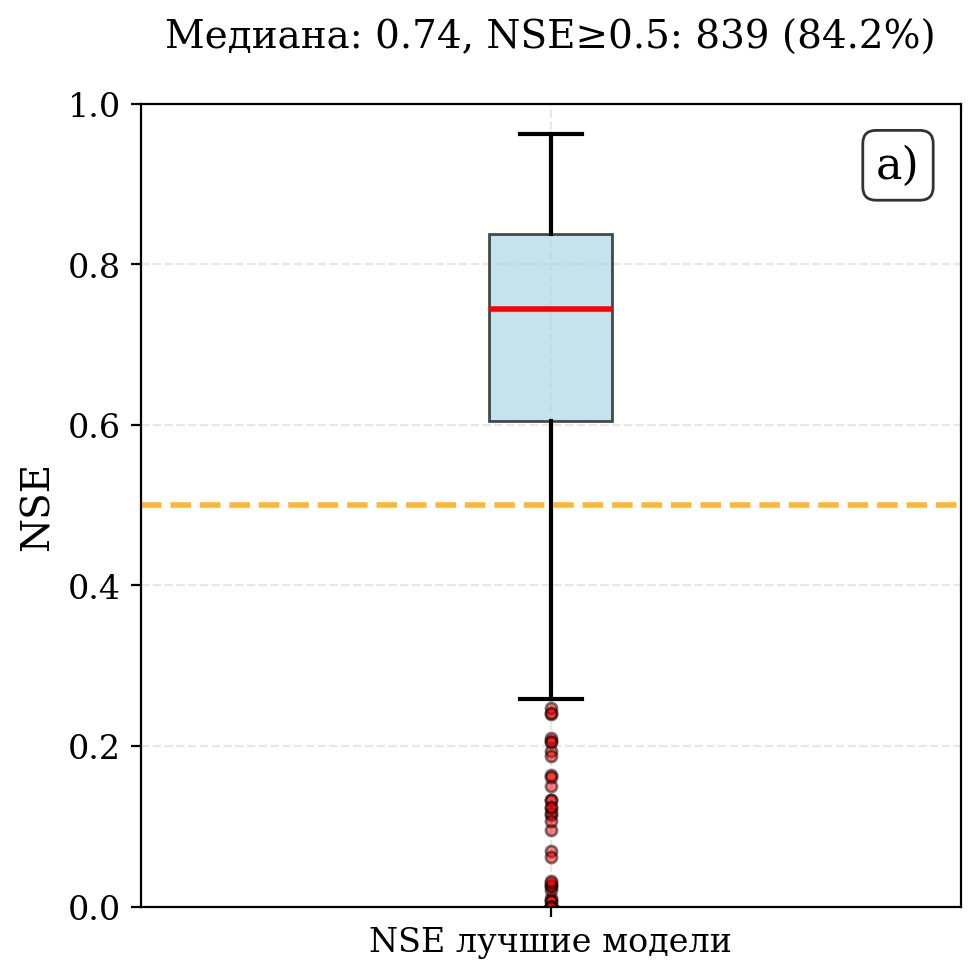

In [ ]:
# plot error distibution for best model nse
fig = create_nse_boxplots(
    df=lstm_geom_nse,
    nse_columns=["NSE лучшие модели"],
    figsize=(5, 5),
    max_cols=1,
    color="lightblue",
    save_path="../conclusions/images/LSTM_best_model_boxplots.png",  # Specify the path to save the figure,
)

In [ ]:
best_model_stat = (
    pd.concat([best_hbv, best_gr4j, best_rfr, best_by_gauge, best_no_phys, best_lstm])
    .median()
    .to_frame()
    .T
)

best_model_stat.index = pd.Index(["Лучшие модели стока"])
best_model_stat.index.name = "Модель"

best_model_stat.to_excel("../data/dw_tables/best_model_stat.xlsx", float_format="%.2f")

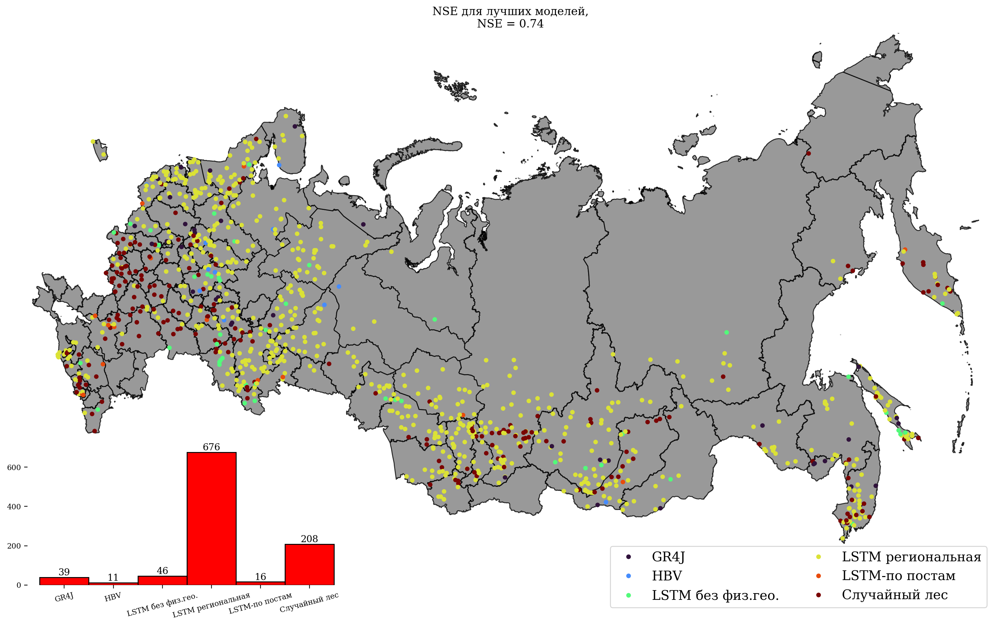

In [ ]:
for name, index in {
    "HBV": hbv_index,
    "GR4J": gr4j_index,
    "Случайный лес": rfr_index,
    "LSTM-по постам": lstm_by_gauge_index,
    "LSTM без физ.гео.": lstm_no_phys_geo_index,
    "LSTM региональная": lstm_best_index,
}.items():
    lstm_geom_nse.loc[index, "Лучшая гидро модель"] = name
for i, geom in enumerate(basin_districts["geometry"]):
    ugms_part = lstm_geom_nse.loc[
        [geom.intersects(gage_point) for gage_point in lstm_geom_nse["geometry"]],
        :,
    ]
    ugms_name = basin_districts.loc[i, "name1"]

    basin_districts.loc[i, ["Best Model NSE"]] = ugms_part[["Best Model NSE"]].median()
    lstm_geom_nse.loc[
        [geom.intersects(gage_point) for gage_point in lstm_geom_nse["geometry"]],
        "Бассейновый округ",
    ] = ugms_name

basin_districts.loc[[26, 27], ["Best Meteo NSE"]] = np.nan
basin_districts.loc[[26, 27], ["Best Model NSE"]] = np.nan
gauges_fig = russia_plots(
    gdf_to_plot=lstm_geom_nse,
    basemap_data=basemap_data,
    distinction_col="Лучшая гидро модель",
    cmap_name="turbo",
    # list_of_limits=list(range(0, 6)),
    title_text=f"NSE для лучших моделей,\nNSE = {lstm_geom_nse['Best Model NSE'].median():.2f}",
    figsize=(15, 10),
    just_points=True,
    legend_cols=2,
    with_histogram=True,
)


In [ ]:
from visualizations.scripts.hex_maps import hex_model_distribution_plot

cond_ws = ws_file[["geometry", "Лучшая гидро модель"]]


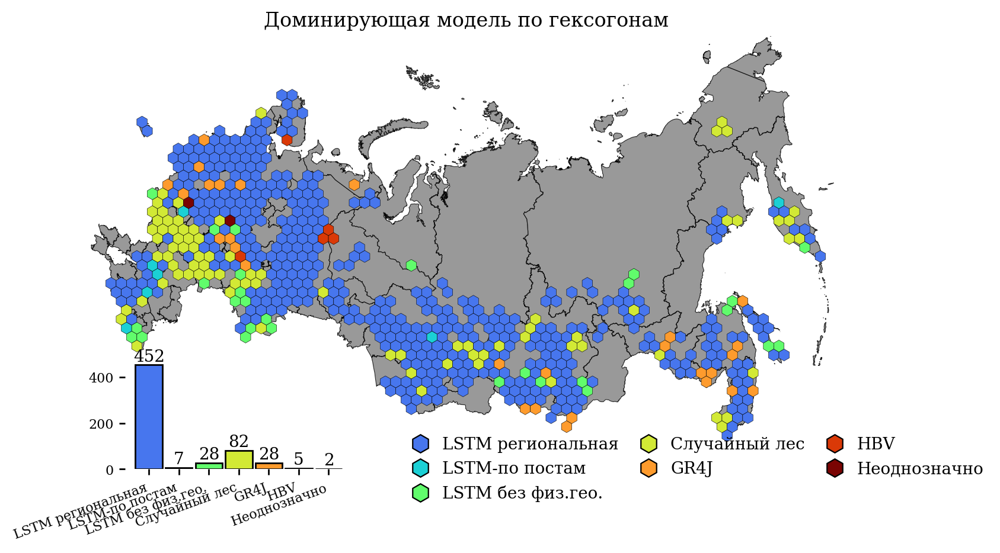

In [ ]:
model_dict = {
    "LSTM региональная": 1.0,
    "LSTM-по постам": 2.0,
    "LSTM без физ.гео.": 3.0,
    "Случайный лес": 4.0,
    "GR4J": 5.0,
    "HBV": 6.0,
}

fig, ax, hexes_gdf, counts = hex_model_distribution_plot(
    cond_ws,
    basemap_data,
    model_col="Лучшая гидро модель",
    model_dict=model_dict,
    min_overlap_share=0.15,
    cmap_name="turbo",
    dominant_threshold=0.33,
    target_ws_per_hex=6,
    skip_colors=1,  # drop the first turbo swatch
    legend_columns=3,
    legend_kwargs={"loc": "lower left", "bbox_to_anchor": (0.40, -0.05)},
    histogram_label_rotation=20,
    title="Доминирующая модель по гексогонам",
)


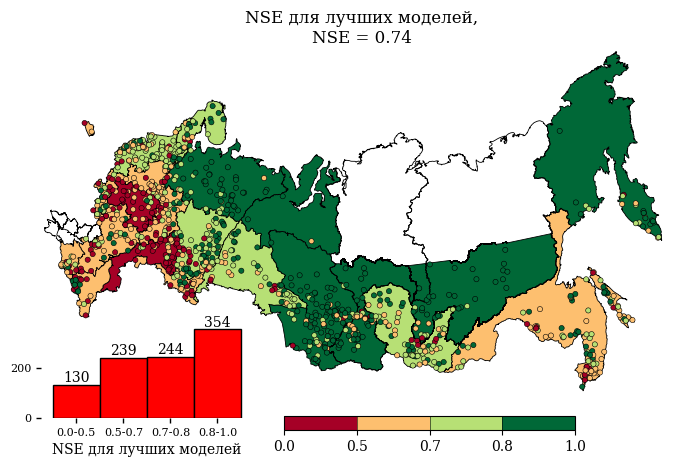

In [ ]:
for i, geom in enumerate(basin_districts["geometry"]):
    ugms_part = lstm_geom_nse.loc[
        [geom.intersects(gage_point) for gage_point in lstm_geom_nse["geometry"]],
        :,
    ]
    ugms_name = basin_districts.loc[i, "name1"]

    basin_districts.loc[i, ["Best Model NSE"]] = ugms_part[["Best Model NSE"]].median()

basin_districts.loc[[26, 27], ["Best Model NSE"]] = np.nan

meteo_nse = russia_plots_n(
    gdf_to_plot=lstm_geom_nse,
    basemap_data=basemap_data,
    figsize=(10, 5),
    nrows=1,
    ncols=1,
    label_list=[""],
    columns_from_gdf=[
        "Best Model NSE",
    ],
    hist_name=["NSE для лучших моделей"],
    with_histogram=True,
    title_text=[
        f"NSE для лучших моделей,\nNSE = {lstm_geom_nse['Best Model NSE'].median():.2f}",
        f"NSE для лучших LSTM,\nNSE = {lstm_geom_nse['Best Meteo NSE'].median():.2f}",
    ],
    ugms=True,
    ugms_gdf=basin_districts.sort_index(),
)


In [ ]:
hydro_model_table = pd.concat(
    [
        hbv_table.loc[common_index, :].median().to_frame().T,
        gr4j_table.loc[common_index, :].median().to_frame().T,
        rfr_table.loc[common_index, :].median().to_frame().T,
        lstm_single_table.loc[common_index, :].median().to_frame().T,
        lstm_vanila_table.loc[common_index, :].median().to_frame().T,
        lstm_best_table.loc[common_index, :].median().to_frame().T,
    ]
)
hydro_model_table

,NSE,KGE,r,alpha,beta,RMSE,delta
0,0.357778,0.344206,0.709393,1.200966,1.304887,0.604140,26.675534
0,0.443085,0.459946,0.733627,1.219051,1.036671,0.558919,-32.811098
0,0.559061,0.659988,0.789579,1.042802,0.979286,0.559982,-23.696445
0,0.255493,0.110941,0.611435,1.687650,1.034740,0.651856,-42.235350
0,0.426738,0.378419,0.752681,1.353148,1.111073,0.616275,-18.234477
0,0.721158,0.681662,0.883332,1.146357,1.034411,0.377659,-14.164371


In [ ]:
pd.concat(
    [
        hbv_table.loc[hbv_index, :].median().to_frame().T,
        gr4j_table.loc[gr4j_index, :].median().to_frame().T,
        rfr_table.loc[rfr_index, :].median().to_frame().T,
        lstm_single_table.loc[lstm_by_gauge_index, :].median().to_frame().T,
        lstm_vanila_table.loc[lstm_no_phys_geo_index, :].median().to_frame().T,
        lstm_best_table.loc[lstm_best_index, :].median().to_frame().T,
    ]
)

,NSE,KGE,r,alpha,beta,RMSE,delta
0,0.668282,0.708480,0.863202,1.181329,1.074758,0.416571,6.212686
0,0.600167,0.576617,0.819416,1.318886,1.025443,0.572507,-44.861588
0,0.683931,0.737925,0.853265,1.041136,0.957292,0.311509,-20.828199
0,0.424312,-0.143921,0.692257,1.957762,1.022717,0.162468,-17.578793
0,0.589756,0.568417,0.817760,1.189555,0.974354,0.335004,-36.954951
0,0.779652,0.725161,0.906024,1.153821,1.032354,0.404046,-14.534233


In [ ]:
basin_districts.loc[:, ["name1", "Best Model NSE"]].dropna().to_csv(
    "../data/dw_tables/bo_lstm_best_model.csv", index=False
)
lstm_regional_table_stat = pd.concat([lstm_regional_table.median().to_frame().T])
lstm_regional_table_stat.index = pd.Index(["Лучшая модель стока"])
lstm_regional_table_stat.index.name = "Модель"
lstm_regional_table_stat.to_excel(
    "../data/dw_tables/models_regional_statistics.xlsx", float_format="%.2f"
)
lstm_regional_table_stat

AttributeError: 'float' object has no attribute 'to_frame'

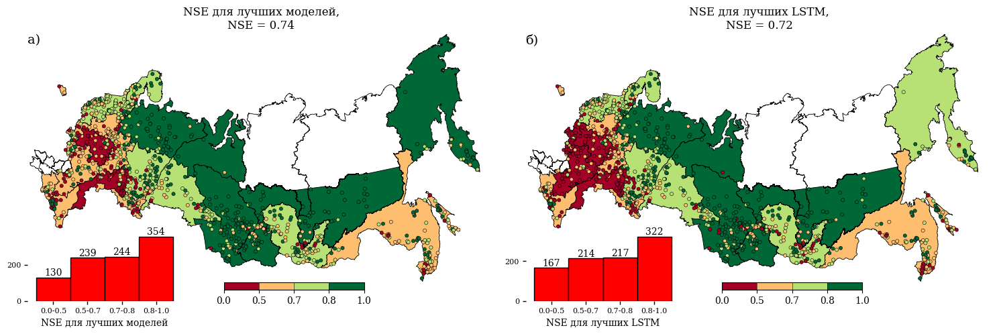

In [ ]:
for i, geom in enumerate(basin_districts["geometry"]):
    ugms_part = lstm_geom_nse.loc[
        [geom.intersects(gage_point) for gage_point in lstm_geom_nse["geometry"]],
        :,
    ]
    ugms_name = basin_districts.loc[i, "name1"]

    basin_districts.loc[i, ["Best Model NSE"]] = ugms_part[["Best Model NSE"]].median()

basin_districts.loc[[26, 27], ["Best Model NSE"]] = np.nan

meteo_nse = russia_plots_n(
    gdf_to_plot=lstm_geom_nse,
    basemap_data=basemap_data,
    figsize=(15, 10),
    nrows=1,
    ncols=2,
    label_list=["а)", "б)"],
    columns_from_gdf=["Best Model NSE", "Best Meteo NSE"],
    hist_name=["NSE для лучших моделей", "NSE для лучших LSTM"],
    with_histogram=True,
    title_text=[
        f"NSE для лучших моделей,\nNSE = {lstm_geom_nse['Best Model NSE'].median():.2f}",
        f"NSE для лучших LSTM,\nNSE = {lstm_geom_nse['Best Meteo NSE'].median():.2f}",
    ],
    ugms=True,
    ugms_gdf=basin_districts.sort_index(),
)


In [ ]:
lstm_geom_nse.drop("geometry", axis=1).to_csv("../data/dw_tables/StatByGauge.csv")


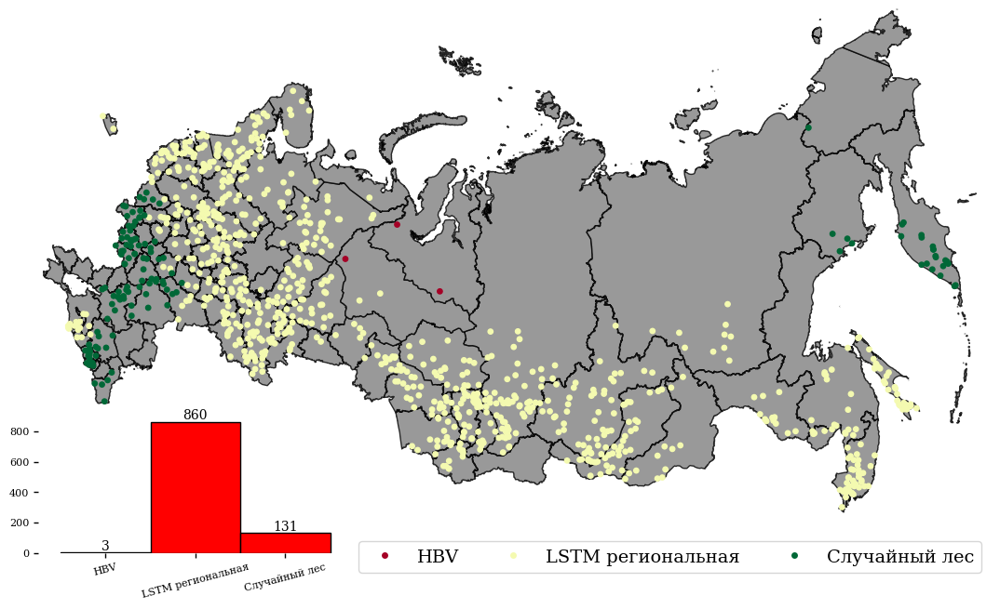

In [ ]:
lstm_geom_nse_type = deepcopy(lstm_geom_nse)

model_dict = {
    "HBV": 1,
    "GR4J": 2,
    "Случайный лес": 3,
    "LSTM-по постам": 4,
    "LSTM без физ.гео.": 5,
    "LSTM региональная": 6,
    "Неоднозначно": 7,
    np.nan: np.nan,
}
cool_model = np.nan
for i, geom in enumerate(basin_districts["geometry"]):
    ugms_part = lstm_geom_nse_type.loc[
        [geom.intersects(gage_point) for gage_point in lstm_geom_nse_type["geometry"]],
        :,
    ]
    ugms_name = basin_districts.loc[i, "name1"]
    try:
        example = ugms_part["Лучшая гидро модель"].value_counts()

        for model, value in example.items():
            if value / example.sum() > 0.33:
                cool_model = model
                break
            else:
                cool_model = "Неоднозначно"

        # basin_districts.loc[i, ["Лучшая гидро модель"]] = ugms_part["Лучшая гидро модель"].value_counts().index[0]
        # basin_districts.loc[i, ["Лучшая гидро модель"]] = model_dict[
        #     ugms_part["Лучшая гидро модель"].value_counts().index[0]
        # ]
        basin_districts.loc[i, ["Лучшая гидро модель"]] = model_dict[cool_model]
        lstm_geom_nse_type.loc[
            [
                geom.intersects(gage_point)
                for gage_point in lstm_geom_nse_type["geometry"]
            ],
            ["Лучшая гидро модель"],
        ] = cool_model
    except IndexError:
        basin_districts.loc[i, ["Лучшая гидро модель"]] = np.nan
basin_districts.loc[[26, 27], ["Лучшая гидро модель"]] = np.nan
# lstm_geom_nse_type["Лучшая гидро модель"] = [model_dict[i] for i in lstm_geom_nse_type["Лучшая гидро модель"]]

gauges_fig = russia_plots(
    gdf_to_plot=lstm_geom_nse_type,
    basemap_data=basemap_data,
    distinction_col="Лучшая гидро модель",
    # cmap_name="turbo",
    list_of_limits=list(range(1, 5)),
    figsize=(15, 8),
    just_points=True,
    legend_cols=3,
    with_histogram=True,
)


,NSE,KGE,r,alpha,beta,RMSE,delta
gauge_id,,,,,,,
11538,0.836731,0.708658,0.924826,1.197116,1.200933,0.635056,32.143240
75236,0.539106,0.342627,0.744381,1.604598,1.035491,1.140388,-71.129625
70339,0.844391,0.788413,0.922275,1.165542,1.106413,1.068744,-2.945966
75607,0.665590,0.708302,0.887564,0.837801,0.785205,0.331991,-41.786566
75656,0.518891,0.730956,0.826556,0.813245,0.913834,0.243334,15.371338
...,...,...,...,...,...,...,...
74438,0.458833,0.496285,0.763222,1.372582,0.757415,0.327894,-71.532950
70118,0.770001,0.342890,0.940981,1.551163,1.352887,1.099137,3.535722
72577,0.823620,0.635320,0.940694,1.303860,1.192726,0.300961,1.790162


In [ ]:
final_table = list()


def table_statistics(table: pd.DataFrame, table_name: str):
    nse_row = pd.DataFrame()
    nse_row.loc[table_name, "Постов в исследовании"] = f"{table['NSE'].__len__():.0f}"
    nse_row.loc[table_name, "NSE медиана"] = f"{(table['NSE'].median()):.2f}"
    nse_row.loc[table_name, "NSE < 0.5"] = f"{(table['NSE'] < 0.5).sum():.0f}"
    nse_row.loc[table_name, "NSE < 0"] = f"{(table['NSE'] < 0).sum():.0f}"
    nse_row.loc[table_name, "NSE > 0.5"] = f"{((table['NSE'] > 0.5).sum()):.0f}"
    nse_row.loc[table_name, "NSE удовл., %"] = (
        f"{((table['NSE'] > 0.5).sum() / table['NSE'].__len__()):.1%}"
    )

    return nse_row


table_dict = {
    "HBV": hbv_table.loc[common_index, :],
    "GR4J": gr4j_table.loc[common_index, :],
    "Случайный лес": rfr_table.loc[common_index, :],
    "LSTM MSWEP": lstm_regional_table.loc[common_index, :],
    "LSTM-по постам": lstm_single_table.loc[common_index, :],
    "LSTM без физ.гео.": lstm_vanila_table.loc[common_index, :],
    "LSTM лучшие": lstm_best_table.loc[common_index, :],
    "Модели лучшие": pd.concat(
        [best_hbv, best_gr4j, best_rfr, best_by_gauge, best_no_phys, best_lstm]
    ).loc[common_index, :],
}

for name, table in table_dict.items():
    final_table.append(table_statistics(table=table, table_name=name))
final_table = pd.concat(final_table)
final_table = final_table.sort_values(by="NSE медиана", ascending=False)
final_table.to_excel("../data/dw_tables/nse_table_result.xlsx", float_format="%.2f")
final_table


,Постов в исследовании,NSE медиана,NSE < 0.5,NSE < 0,NSE > 0.5,"NSE удовл., %"
Модели лучшие,996,0.74,157,27,839,84.2%
LSTM лучшие,996,0.72,241,74,755,75.8%
LSTM MSWEP,996,0.64,340,121,656,65.9%
Случайный лес,996,0.56,405,123,591,59.3%
GR4J,996,0.44,572,206,424,42.6%
LSTM без физ.гео.,996,0.43,607,219,389,39.1%
HBV,996,0.36,643,271,353,35.4%
LSTM-по постам,996,0.26,836,199,160,16.1%
